In [1]:
import os

## Set directory
os.chdir('/hpc/group/pbenfeylab/CheWei/CW_data/genesys')

import networkx as nx
from genesys_evaluate_v1 import *
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import seaborn as sns
import anndata

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
## Conda Env genesys on DCC
print(torch.__version__)
print(sc.__version__) 

1.11.0
1.9.6


In [3]:
## Genes considered/used (shared among samples) 
gene_list = pd.read_csv('./gene_list_1108.csv')

## Load data

In [4]:
with open("./genesys_root_data.pkl", 'rb') as file_handle:
    data = pickle.load(file_handle)
    
batch_size = 2000
dataset = Root_Dataset(data['X_test'], data['y_test'])
loader = DataLoader(dataset,
                         batch_size = batch_size,
                         shuffle = True, drop_last=True)
train_dataset = Root_Dataset(data['X_train'], data['y_train'])
train_loader = DataLoader(train_dataset,
                         batch_size = batch_size,
                         shuffle = True, drop_last=True)

In [5]:
with open("./genesys_rswt_data.pkl", 'rb') as file_handle:
    data = pickle.load(file_handle)

X_all = np.vstack((data['X_train'],data['X_val'],data['X_test']))
y_all = pd.concat((data['y_train'],data['y_val'],data['y_test']))
unseen_dataset = Root_Dataset_NoQC(X_all, y_all)
unseen_loader = DataLoader(unseen_dataset,
                         batch_size = batch_size,
                         shuffle = True, drop_last=True)

In [6]:
input_size = data['X_train'].shape[1]
## 10 cell types 
output_size = 10
embedding_dim = 256
hidden_dim = 256
n_layers = 2
device = "cpu"
path = "./"

## Load trained GeneSys model (Evaluate)

In [7]:
model = ClassifierLSTM(input_size, output_size, embedding_dim, hidden_dim, n_layers).to(device)
model.load_state_dict(torch.load(path+"/workstation/genesys_model_trained_on_root_atlas_20240308_continue4.pth", map_location=torch.device('cpu')))
model = model
model.eval()

ClassifierLSTM(
  (fc1): Sequential(
    (0): Linear(in_features=17513, out_features=256, bias=True)
    (1): Dropout(p=0.2, inplace=False)
    (2): GaussianNoise()
  )
  (fc): Sequential(
    (0): ReLU()
    (1): Linear(in_features=512, out_features=512, bias=True)
    (2): ReLU()
    (3): Linear(in_features=512, out_features=10, bias=True)
  )
  (lstm): LSTM(256, 256, num_layers=2, batch_first=True, dropout=0.2, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (b_to_z): DBlock(
    (fc1): Linear(in_features=512, out_features=256, bias=True)
    (fc2): Linear(in_features=512, out_features=256, bias=True)
    (fc_mu): Linear(in_features=256, out_features=512, bias=True)
    (fc_logsigma): Linear(in_features=256, out_features=512, bias=True)
  )
  (bz2_infer_z1): DBlock(
    (fc1): Linear(in_features=1024, out_features=256, bias=True)
    (fc2): Linear(in_features=1024, out_features=256, bias=True)
    (fc_mu): Linear(in_features=256, out_features=512, bias=True)
    (fc

### Sample data (2000 cells)

In [8]:
with open("./genesys_root_data.pkl", 'rb') as file_handle:
    data = pickle.load(file_handle)
    
batch_size = 2000
dataset = Root_Dataset(data['X_test'], data['y_test'])
loader = DataLoader(dataset,
                         batch_size = batch_size,
                         shuffle = True, drop_last=True)
train_dataset = Root_Dataset(data['X_train'], data['y_train'])
train_loader = DataLoader(train_dataset,
                         batch_size = batch_size,
                         shuffle = True, drop_last=True)

In [9]:
classes = ['Columella', 'Lateral Root Cap', 'Phloem', 'Xylem', 'Procambium', 'Pericycle', 'Endodermis', 'Cortex', 'Atrichoblast', 'Trichoblast']
class2num = {c: i for (i, c) in enumerate(classes)}
num2class = {i: c for (i, c) in enumerate(classes)}

In [10]:
sample = next(iter(loader))
xo = sample['x'].to(device)
y = sample['y'].to(device)
y_label = [num2class[i] for i in y.tolist()]

In [11]:
## 2000 cell type trajectories (11 dev stage) sampled, each stage has 17513 gene expression)
xo.shape

torch.Size([2000, 11, 17513])

In [12]:
## How many cell type trajectories are sampled for each cell type?
pd.Series(y_label).value_counts()

Trichoblast         224
Xylem               213
Cortex              212
Endodermis          212
Procambium          196
Columella           196
Phloem              193
Atrichoblast        191
Lateral Root Cap    182
Pericycle           181
dtype: int64

### Gene masking impact on development

In [13]:
model = ClassifierLSTM(input_size, output_size, embedding_dim, hidden_dim, n_layers).to(device)
model.load_state_dict(torch.load(path+"/workstation/genesys_model_trained_on_root_atlas_20240308_continue4.pth", map_location=torch.device('cpu')))
model = model
model.eval()

ClassifierLSTM(
  (fc1): Sequential(
    (0): Linear(in_features=17513, out_features=256, bias=True)
    (1): Dropout(p=0.2, inplace=False)
    (2): GaussianNoise()
  )
  (fc): Sequential(
    (0): ReLU()
    (1): Linear(in_features=512, out_features=512, bias=True)
    (2): ReLU()
    (3): Linear(in_features=512, out_features=10, bias=True)
  )
  (lstm): LSTM(256, 256, num_layers=2, batch_first=True, dropout=0.2, bidirectional=True)
  (dropout): Dropout(p=0.2, inplace=False)
  (b_to_z): DBlock(
    (fc1): Linear(in_features=512, out_features=256, bias=True)
    (fc2): Linear(in_features=512, out_features=256, bias=True)
    (fc_mu): Linear(in_features=256, out_features=512, bias=True)
    (fc_logsigma): Linear(in_features=256, out_features=512, bias=True)
  )
  (bz2_infer_z1): DBlock(
    (fc1): Linear(in_features=1024, out_features=256, bias=True)
    (fc2): Linear(in_features=1024, out_features=256, bias=True)
    (fc_mu): Linear(in_features=256, out_features=512, bias=True)
    (fc

## Define functions

In [21]:
def recovery(matched_idx, output_dir_and_file_name):
    y_pred, y_true = [], []
    
    with torch.no_grad():
        for sample in loader:
            x = sample['x'].to(device)
            
            # remove/keep genes
            to_keep = x[:,:,matched_idx]
            # remove all gene expression
            x[:,:,:]=x[:,:,:].zero_()
            # add back the gene expression for selected genes
            x[:,:,matched_idx]= to_keep
            
            x10 = torch.stack([x[:,0,:],x[:,1,:],x[:,2,:],x[:,3,:],x[:,4,:],x[:,5,:],x[:,6,:],x[:,7,:],x[:,8,:],x[:,9,:],x[:,10,:]],dim=1)
            y = sample['y'].to(device)
            y_true.append(y.cpu().detach().numpy())
            test_h = model.init_hidden(batch_size)
            p, pred_h = model.predict_proba(x10, test_h, 10)
            y_pred.append(p.cpu().detach().numpy())
    
            
    y_true = np.concatenate(y_true)
    y_pred = np.concatenate(y_pred)

    # Compute overall recovery
    overall_recovery = (y_true == np.argmax(y_pred, axis=1)).mean()
    
    # Store results in a dictionary
    results = {'Celltype': ['Overall'], 'Recovery': [overall_recovery]}
    
    # Define cell types
    classes = ['Columella', 'Lateral Root Cap', 'Phloem', 'Xylem', 'Procambium',
               'Pericycle', 'Endodermis', 'Cortex', 'Atrichoblast', 'Trichoblast']
    
    # Compute recovery per cell type
    for ct in range(10):
        idx = np.where(y_true == ct)
        recovery = (y_true[idx] == np.argmax(y_pred, axis=1)[idx]).mean()
        results['Celltype'].append(classes[ct])
        results['Recovery'].append(recovery)
    
    # Convert to DataFrame
    df = pd.DataFrame(results)
    print(df)
    
    # Save to CSV
    df.to_csv(output_dir_and_file_name, index=False)

In [22]:
def gof(matched_idx):
    # Find indices where query_list elements match
    #matched_idx = [i for i, x in enumerate(gene_list['features']) if x in set(GEP_dict[GEP])]
    matched_idx = matched_idx
    #len(gene_list['features'][matched_idx])
    
    #Prepare 
    xm = xo.clone()
    # remove/keep genes
    to_keep = xm[:,:,matched_idx]
    xm[:,:,:]=xm[:,:,:].zero_()
    xm[:,:,matched_idx]= to_keep
    ## Provide entire tracks
    x = torch.stack([xm[:,0,:],xm[:,1,:],xm[:,2,:],xm[:,3,:],xm[:,4,:],xm[:,5,:],xm[:,6,:],xm[:,7,:],xm[:,8,:],xm[:,9,:],xm[:,10,:]],dim=1)
    ## Provide the first two bins 
    #x = torch.stack([xm[:,0,:],xm[:,1,:],xm[:,2,:],xm[:,2,:],xm[:,2,:],xm[:,2,:],xm[:,2,:],xm[:,2,:],xm[:,2,:],xm[:,2,:],xm[:,2,:]],dim=1)

    ## Initialize hidden state
    pred_h = model.init_hidden(batch_size)
    
    # t0 and t1 prediction based on data from the first two time points
    t0 = model.generate_current(x, pred_h, 0)
    
    ## predict t1 label
    y0, pred_h = model.predict_proba(x, pred_h, 0)
    y0 = [num2class[i] for i in np.argmax(y0.cpu().detach().numpy(), axis=1)]
    
    t1 = model.generate_next(x, pred_h, 0)
    
    y1, pred_h = model.predict_proba(x, pred_h, 1)
    y1 = [num2class[i] for i in np.argmax(y1.cpu().detach().numpy(), axis=1)]

    t2 = model.generate_next(x, pred_h, 1)
    
    y2, pred_h = model.predict_proba(x, pred_h, 2)
    y2 = [num2class[i] for i in np.argmax(y2.cpu().detach().numpy(), axis=1)]
    
    t3 = model.generate_next(x, pred_h, 2)
    
    y3, pred_h = model.predict_proba(x, pred_h, 3)
    y3 = [num2class[i] for i in np.argmax(y3.cpu().detach().numpy(), axis=1)]
    
    t4 = model.generate_next(x, pred_h, 3)
    
    y4, pred_h = model.predict_proba(x, pred_h, 4)
    y4 = [num2class[i] for i in np.argmax(y4.cpu().detach().numpy(), axis=1)]

    t5 = model.generate_next(x, pred_h, 4)
    
    y5, pred_h = model.predict_proba(x, pred_h, 5)
    y5 = [num2class[i] for i in np.argmax(y5.cpu().detach().numpy(), axis=1)]
    
    t6 = model.generate_next(x, pred_h, 5)
    
    y6, pred_h = model.predict_proba(x, pred_h, 6)
    y6 = [num2class[i] for i in np.argmax(y6.cpu().detach().numpy(), axis=1)]
    
    t7 = model.generate_next(x, pred_h, 6)

    y7, pred_h = model.predict_proba(x, pred_h, 7)
    y7 = [num2class[i] for i in np.argmax(y7.cpu().detach().numpy(), axis=1)]
    
    t8 = model.generate_next(x, pred_h, 7)
    
    y8, pred_h = model.predict_proba(x, pred_h, 8)
    y8 = [num2class[i] for i in np.argmax(y8.cpu().detach().numpy(), axis=1)]
    
    t9 = model.generate_next(x, pred_h, 8)

    y9, pred_h = model.predict_proba(x, pred_h, 9)
    y9 = [num2class[i] for i in np.argmax(y9.cpu().detach().numpy(), axis=1)]
    
    t10 = model.generate_next(x, pred_h, 9)
    
    y10, pred_h = model.predict_proba(x, pred_h, 10)
    y10 = [num2class[i] for i in np.argmax(y10.cpu().detach().numpy(), axis=1)]

    t0 = t0.to(device).detach().numpy()
    t1 = t1.to(device).detach().numpy()
    t2 = t2.to(device).detach().numpy()
    t3 = t3.to(device).detach().numpy()
    t4 = t4.to(device).detach().numpy()
    t5 = t5.to(device).detach().numpy()
    t6 = t6.to(device).detach().numpy()
    t7 = t7.to(device).detach().numpy()
    t8 = t8.to(device).detach().numpy()
    t9 = t9.to(device).detach().numpy()
    t10 = t10.to(device).detach().numpy()
    
    pred_X = np.vstack((t0,t1,t2,t3,t4,t5,t6,t7,t8,t9,t10))
    pred_Y = np.concatenate((['Stem Cell']*batch_size, y1, y2, y3, y4, y5, y6, y7, y8, y9, y10)).tolist()
    pred_T = ['t0']*batch_size + ['t1']*batch_size + ['t2']*batch_size + ['t3']*batch_size + ['t4']*batch_size + ['t5']*batch_size + ['t6']*batch_size + ['t7']*batch_size + ['t8']*batch_size+ ['t9']*batch_size + ['t10']*batch_size

    # Create AnnData object
    cell_names = [f"Cell_{i}" for i in range(pred_X.shape[0])]
    adata = anndata.AnnData(
        X=pred_X,
        obs=pd.DataFrame(index=cell_names),  # Cell annotations
        var=pd.DataFrame(index=gene_list['features'])   # Gene annotations
    )
    adata.obs['celltype'] = pred_Y
    adata.obs['timebin'] = pred_T

    sc.pp.scale(adata, max_value=10)
    sc.tl.pca(adata, svd_solver='arpack')
    sc.pp.neighbors(adata, n_neighbors=30, n_pcs=50)
    sc.tl.leiden(adata)
    sc.tl.paga(adata)
    sc.pl.paga(adata) 

    sc.tl.umap(adata, init_pos='paga')
    adata.uns['celltype_colors'] = np.array([ "#9400d3","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#9a6324", "#ddaa6f"], dtype=object)
    adata.obs['celltype'] = pd.Categorical(adata.obs['celltype'], categories=["Stem Cell","Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Procambium","Pericycle"])
    sc.pl.umap(adata, color=['celltype'])

    adata.uns['timebin_colors'] = np.array([ '#5E4FA2', '#3288BD', '#66C2A5', '#ABDDA4', '#E6F598', '#FFFFBF', '#FEE08B', '#FDAE61', '#F46D43', '#D53E4F','#9E0142'])
    sc.pl.umap(adata, color=['timebin'])

    ## AT1G79840
    sc.pl.umap(adata, color='AT1G79840', title='AT1G79840 (GL2, Atrichoblast)')
    ## AT5G49270
    sc.pl.umap(adata, color='AT5G49270', title='AT5G49270 (COBL9, Trichoblast)')
    sc.pl.umap(adata, color='AT1G09750', title='AT1G09750 (CORTEX, Cortex)')
    sc.pl.umap(adata, color='AT5G57620', title='AT5G57620 (MYB36, Endodermis)')
    sc.pl.umap(adata, color='AT1G79430', title='AT1G79430 (APL, Phloem)')
    sc.pl.umap(adata, color='AT1G71930', title='AT1G71930 (VND7, Xylem)')
    #sc.pl.umap(adata, color='AT4G37650', title='AT4G37650 (SHR)')    

    return adata

In [23]:
def masked_genes_estimate_recovery(ratio_masked, output_dir_and_file_name):
    y_pred, y_true = [], []
    
    with torch.no_grad():
        for sample in loader:
            x = sample['x'].to(device)

            # Genes switched off
            idx = np.random.choice(x.shape[2] ,int((x.shape[2]*ratio_masked)), replace=False)
            x[:,:,idx]=x[:,:,idx].zero_()
            
            x10 = torch.stack([x[:,0,:],x[:,1,:],x[:,2,:],x[:,3,:],x[:,4,:],x[:,5,:],x[:,6,:],x[:,7,:],x[:,8,:],x[:,9,:],x[:,10,:]],dim=1)
            y = sample['y'].to(device)
            y_true.append(y.cpu().detach().numpy())
            test_h = model.init_hidden(batch_size)
            p, pred_h = model.predict_proba(x10, test_h, 10)
            y_pred.append(p.cpu().detach().numpy())
    
            
    y_true = np.concatenate(y_true)
    y_pred = np.concatenate(y_pred)

    # Compute overall recovery
    overall_recovery = (y_true == np.argmax(y_pred, axis=1)).mean()
    
    # Store results in a dictionary
    results = {'Celltype': ['Overall'], 'Recovery': [overall_recovery]}
    
    # Define cell types
    classes = ['Columella', 'Lateral Root Cap', 'Phloem', 'Xylem', 'Procambium',
               'Pericycle', 'Endodermis', 'Cortex', 'Atrichoblast', 'Trichoblast']
    
    # Compute recovery per cell type
    for ct in range(10):
        idx = np.where(y_true == ct)
        recovery = (y_true[idx] == np.argmax(y_pred, axis=1)[idx]).mean()
        results['Celltype'].append(classes[ct])
        results['Recovery'].append(recovery)
    
    # Convert to DataFrame
    df = pd.DataFrame(results)
    print(df)
    
    # Save to CSV
    df.to_csv(output_dir_and_file_name, index=False)

    #Prepare 
    xm = xo.clone()
    # Genes switched off
    idx = np.random.choice(xm.shape[2] ,int((xm.shape[2]*ratio_masked)), replace=False)
    xm[:,:,idx]=xm[:,:,idx].zero_()
    ## Provide entire tracks
    x = torch.stack([xm[:,0,:],xm[:,1,:],xm[:,2,:],xm[:,3,:],xm[:,4,:],xm[:,5,:],xm[:,6,:],xm[:,7,:],xm[:,8,:],xm[:,9,:],xm[:,10,:]],dim=1)

    ## Initialize hidden state
    pred_h = model.init_hidden(batch_size)
    
    # t0 and t1 prediction based on data from the first two time points
    t0 = model.generate_current(x, pred_h, 0)
    
    ## predict t1 label
    y0, pred_h = model.predict_proba(x, pred_h, 0)
    y0 = [num2class[i] for i in np.argmax(y0.cpu().detach().numpy(), axis=1)]
    
    t1 = model.generate_next(x, pred_h, 0)
    
    y1, pred_h = model.predict_proba(x, pred_h, 1)
    y1 = [num2class[i] for i in np.argmax(y1.cpu().detach().numpy(), axis=1)]

    t2 = model.generate_next(x, pred_h, 1)
    
    y2, pred_h = model.predict_proba(x, pred_h, 2)
    y2 = [num2class[i] for i in np.argmax(y2.cpu().detach().numpy(), axis=1)]
    
    t3 = model.generate_next(x, pred_h, 2)
    
    y3, pred_h = model.predict_proba(x, pred_h, 3)
    y3 = [num2class[i] for i in np.argmax(y3.cpu().detach().numpy(), axis=1)]
    
    t4 = model.generate_next(x, pred_h, 3)
    
    y4, pred_h = model.predict_proba(x, pred_h, 4)
    y4 = [num2class[i] for i in np.argmax(y4.cpu().detach().numpy(), axis=1)]

    t5 = model.generate_next(x, pred_h, 4)
    
    y5, pred_h = model.predict_proba(x, pred_h, 5)
    y5 = [num2class[i] for i in np.argmax(y5.cpu().detach().numpy(), axis=1)]
    
    t6 = model.generate_next(x, pred_h, 5)
    
    y6, pred_h = model.predict_proba(x, pred_h, 6)
    y6 = [num2class[i] for i in np.argmax(y6.cpu().detach().numpy(), axis=1)]
    
    t7 = model.generate_next(x, pred_h, 6)

    y7, pred_h = model.predict_proba(x, pred_h, 7)
    y7 = [num2class[i] for i in np.argmax(y7.cpu().detach().numpy(), axis=1)]
    
    t8 = model.generate_next(x, pred_h, 7)
    
    y8, pred_h = model.predict_proba(x, pred_h, 8)
    y8 = [num2class[i] for i in np.argmax(y8.cpu().detach().numpy(), axis=1)]
    
    t9 = model.generate_next(x, pred_h, 8)

    y9, pred_h = model.predict_proba(x, pred_h, 9)
    y9 = [num2class[i] for i in np.argmax(y9.cpu().detach().numpy(), axis=1)]
    
    t10 = model.generate_next(x, pred_h, 9)
    
    y10, pred_h = model.predict_proba(x, pred_h, 10)
    y10 = [num2class[i] for i in np.argmax(y10.cpu().detach().numpy(), axis=1)]

    t0 = t0.to(device).detach().numpy()
    t1 = t1.to(device).detach().numpy()
    t2 = t2.to(device).detach().numpy()
    t3 = t3.to(device).detach().numpy()
    t4 = t4.to(device).detach().numpy()
    t5 = t5.to(device).detach().numpy()
    t6 = t6.to(device).detach().numpy()
    t7 = t7.to(device).detach().numpy()
    t8 = t8.to(device).detach().numpy()
    t9 = t9.to(device).detach().numpy()
    t10 = t10.to(device).detach().numpy()
    
    pred_X = np.vstack((t0,t1,t2,t3,t4,t5,t6,t7,t8,t9,t10))
    pred_Y = np.concatenate((['Stem Cell']*batch_size, y1, y2, y3, y4, y5, y6, y7, y8, y9, y10)).tolist()
    pred_T = ['t0']*batch_size + ['t1']*batch_size + ['t2']*batch_size + ['t3']*batch_size + ['t4']*batch_size + ['t5']*batch_size + ['t6']*batch_size + ['t7']*batch_size + ['t8']*batch_size+ ['t9']*batch_size + ['t10']*batch_size

    # Create AnnData object
    cell_names = [f"Cell_{i}" for i in range(pred_X.shape[0])]
    adata = anndata.AnnData(
        X=pred_X,
        obs=pd.DataFrame(index=cell_names),  # Cell annotations
        var=pd.DataFrame(index=gene_list['features'])   # Gene annotations
    )
    adata.obs['celltype'] = pred_Y
    adata.obs['timebin'] = pred_T

    sc.pp.scale(adata, max_value=10)
    sc.tl.pca(adata, svd_solver='arpack')
    sc.pp.neighbors(adata, n_neighbors=30, n_pcs=50)
    sc.tl.leiden(adata)
    sc.tl.paga(adata)
    sc.pl.paga(adata) 

    sc.tl.umap(adata, init_pos='paga')
    adata.uns['celltype_colors'] = np.array([ "#9400d3","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#9a6324", "#ddaa6f"], dtype=object)
    adata.obs['celltype'] = pd.Categorical(adata.obs['celltype'], categories=["Stem Cell","Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Procambium","Pericycle"])
    sc.pl.umap(adata, color=['celltype'])

    adata.uns['timebin_colors'] = np.array([ '#5E4FA2', '#3288BD', '#66C2A5', '#ABDDA4', '#E6F598', '#FFFFBF', '#FEE08B', '#FDAE61', '#F46D43', '#D53E4F','#9E0142'])
    sc.pl.umap(adata, color=['timebin'])

    ## AT1G79840
    sc.pl.umap(adata, color='AT1G79840', title='AT1G79840 (GL2, Atrichoblast)')
    ## AT5G49270
    sc.pl.umap(adata, color='AT5G49270', title='AT5G49270 (COBL9, Trichoblast)')
    sc.pl.umap(adata, color='AT1G09750', title='AT1G09750 (CORTEX, Cortex)')
    sc.pl.umap(adata, color='AT5G57620', title='AT5G57620 (MYB36, Endodermis)')
    sc.pl.umap(adata, color='AT1G79430', title='AT1G79430 (APL, Phloem)')
    sc.pl.umap(adata, color='AT1G71930', title='AT1G71930 (VND7, Xylem)')
    #sc.pl.umap(adata, color='AT4G37650', title='AT4G37650 (SHR)')    

    return adata

In [24]:
def masked_genes_estimate_recovery_simple(ratio_masked):
    y_pred, y_true = [], []
    
    with torch.no_grad():
        for sample in loader:
            x = sample['x'].to(device)

            # Genes switched off
            idx = np.random.choice(x.shape[2] ,int((x.shape[2]*ratio_masked)), replace=False)
            x[:,:,idx]=x[:,:,idx].zero_()
            
            x10 = torch.stack([x[:,0,:],x[:,1,:],x[:,2,:],x[:,3,:],x[:,4,:],x[:,5,:],x[:,6,:],x[:,7,:],x[:,8,:],x[:,9,:],x[:,10,:]],dim=1)
            y = sample['y'].to(device)
            y_true.append(y.cpu().detach().numpy())
            test_h = model.init_hidden(batch_size)
            p, pred_h = model.predict_proba(x10, test_h, 10)
            y_pred.append(p.cpu().detach().numpy())
    
            
    y_true = np.concatenate(y_true)
    y_pred = np.concatenate(y_pred)

    # Compute overall recovery
    overall_recovery = (y_true == np.argmax(y_pred, axis=1)).mean()
    
    # Store results in a dictionary
    results = {'Celltype': ['Overall'], 'Recovery': [overall_recovery]}
    
    # Define cell types
    classes = ['Columella', 'Lateral Root Cap', 'Phloem', 'Xylem', 'Procambium',
               'Pericycle', 'Endodermis', 'Cortex', 'Atrichoblast', 'Trichoblast']
    
    # Compute recovery per cell type
    for ct in range(10):
        idx = np.where(y_true == ct)
        recovery = (y_true[idx] == np.argmax(y_pred, axis=1)[idx]).mean()
        results['Celltype'].append(classes[ct])
        results['Recovery'].append(recovery)
    
    # Convert to DataFrame
    df = pd.DataFrame(results)
    return df

## Masked genes

            Celltype  Recovery
0            Overall  0.995955
1          Columella  1.000000
2   Lateral Root Cap  0.979648
3             Phloem  1.000000
4              Xylem  0.999545
5         Procambium  0.999542
6          Pericycle  0.980456
7         Endodermis  1.000000
8             Cortex  1.000000
9       Atrichoblast  0.999563
10       Trichoblast  1.000000


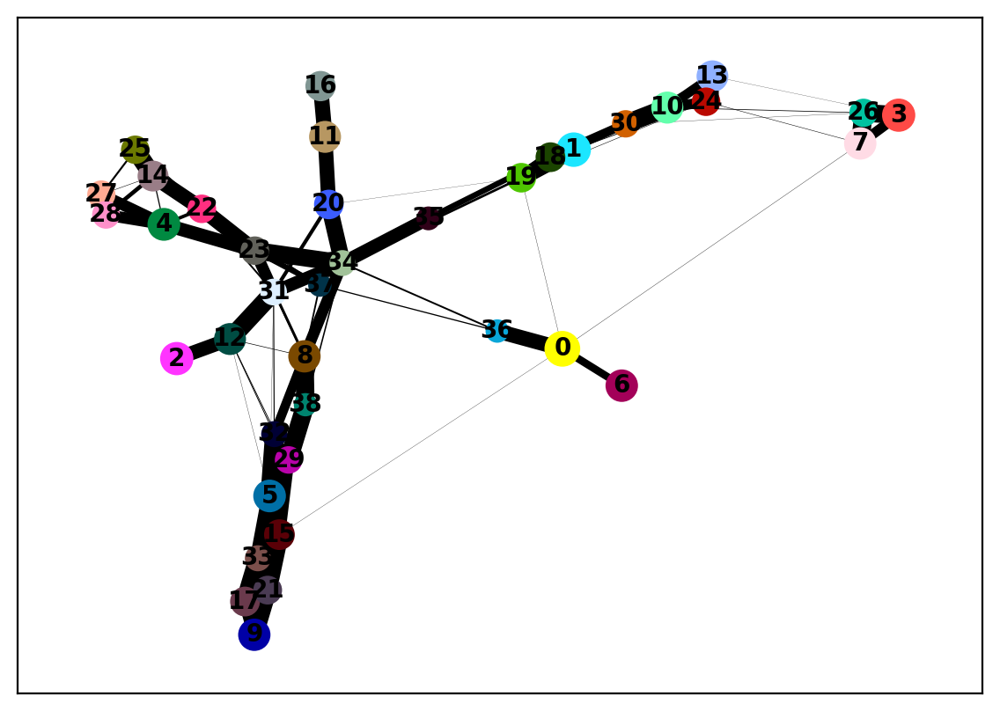

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


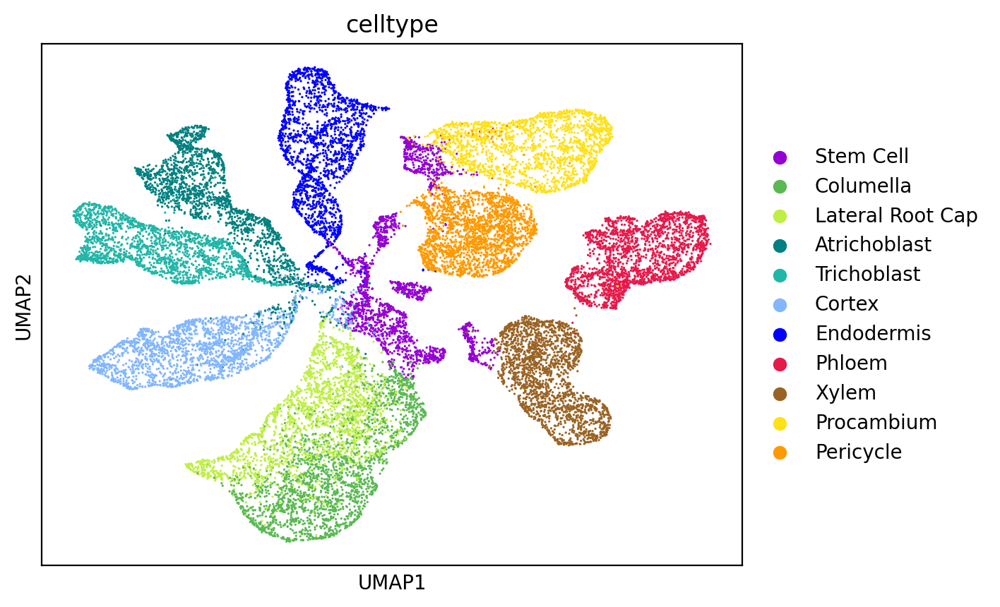

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


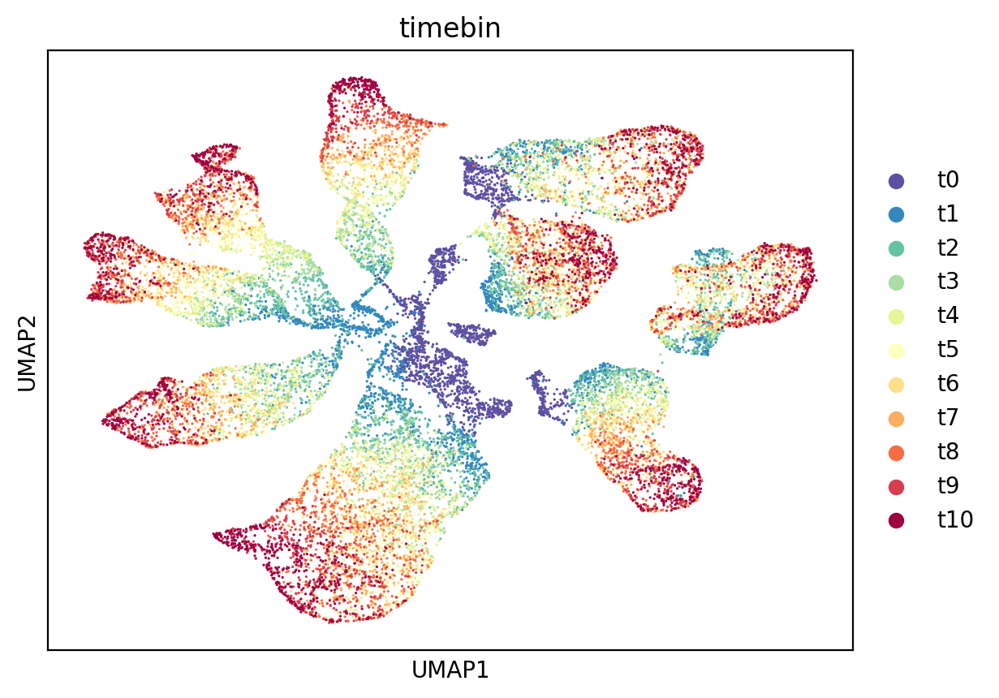

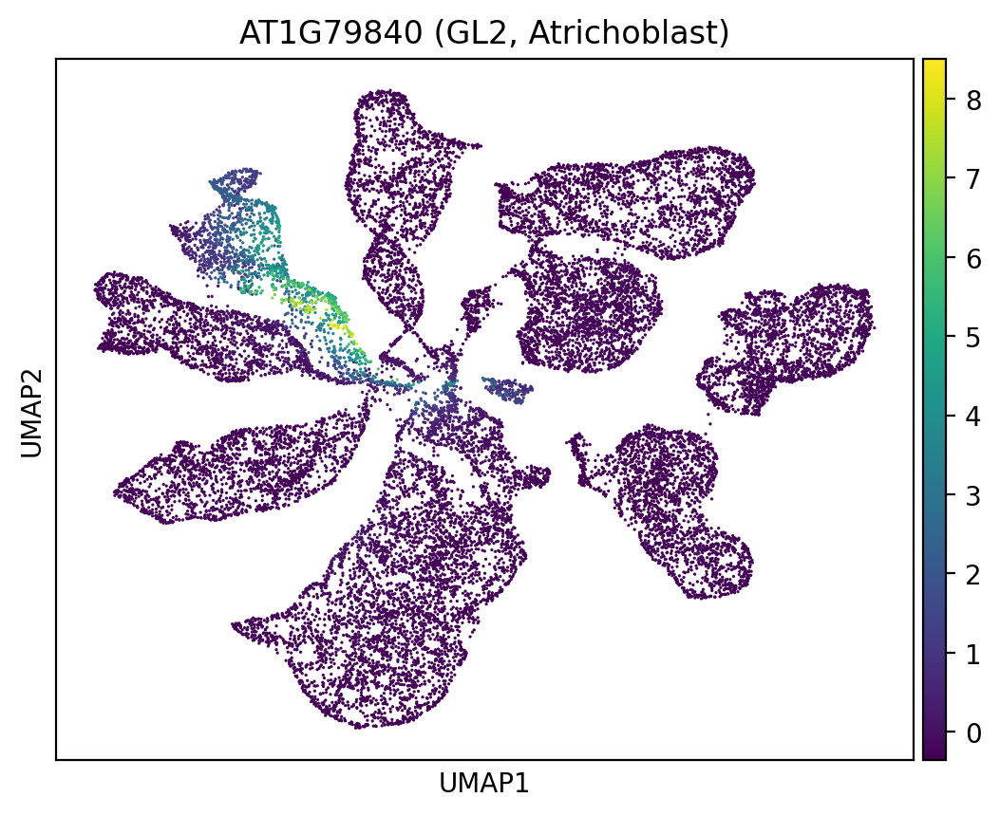

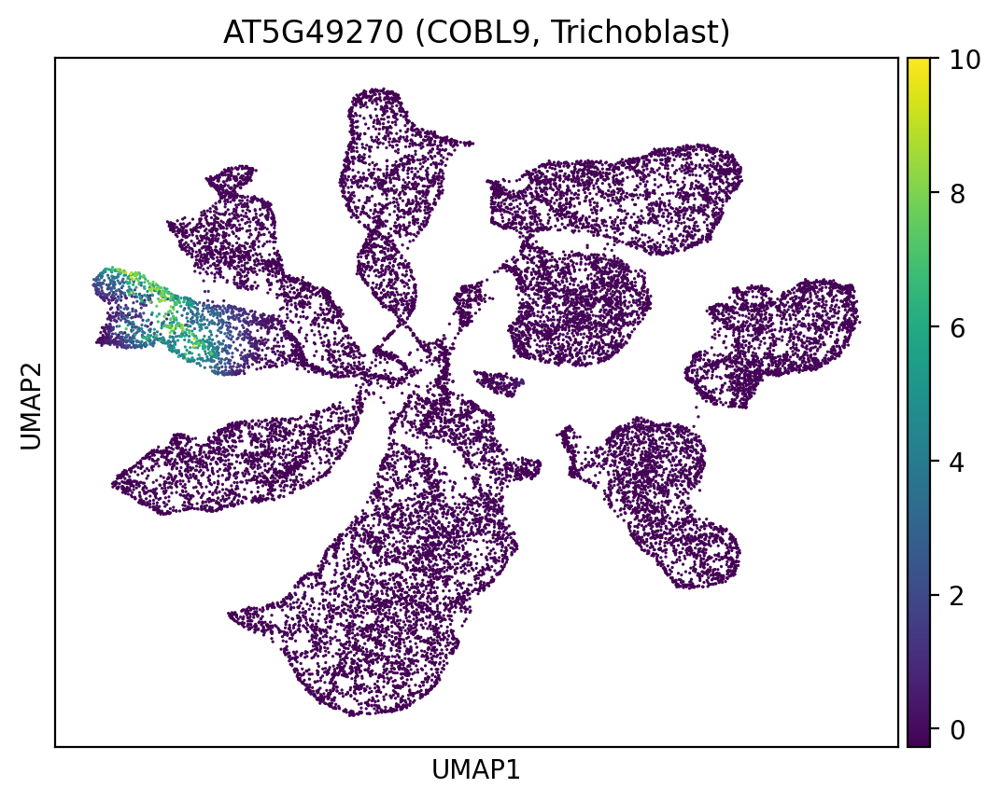

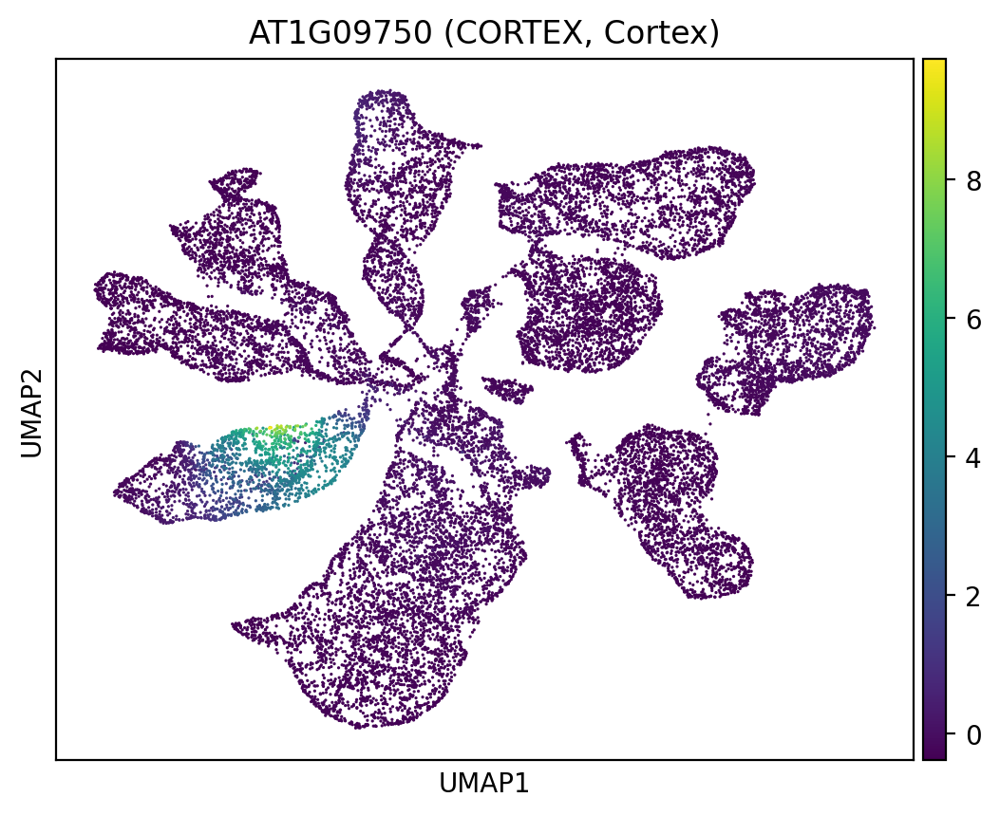

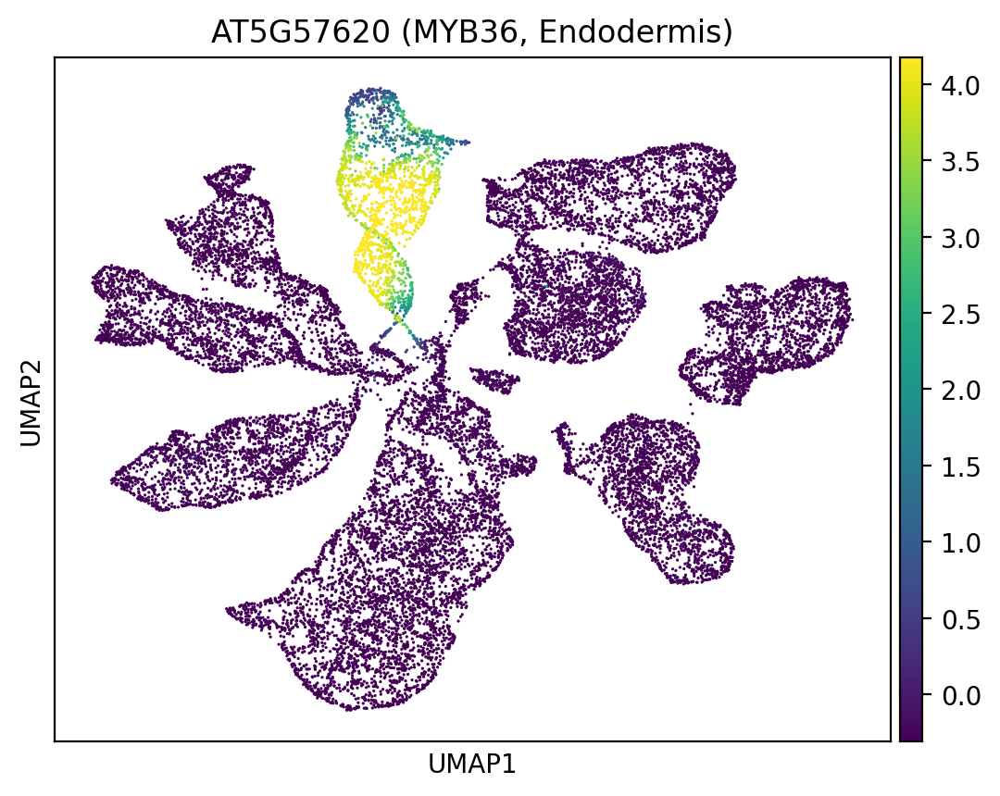

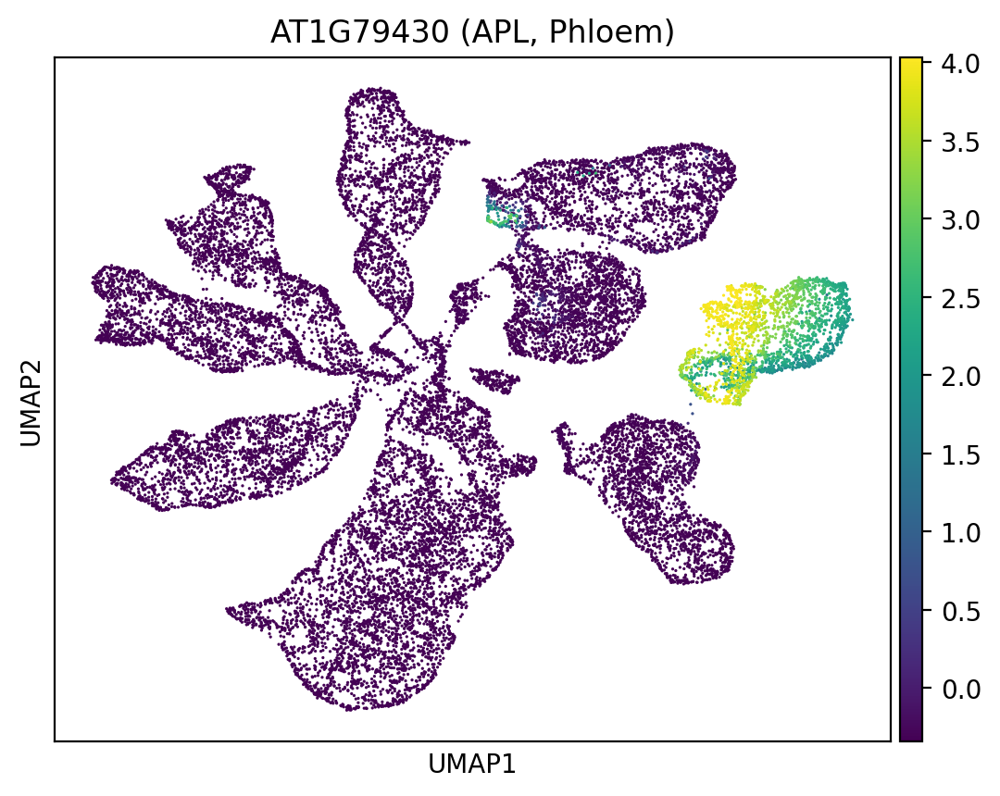

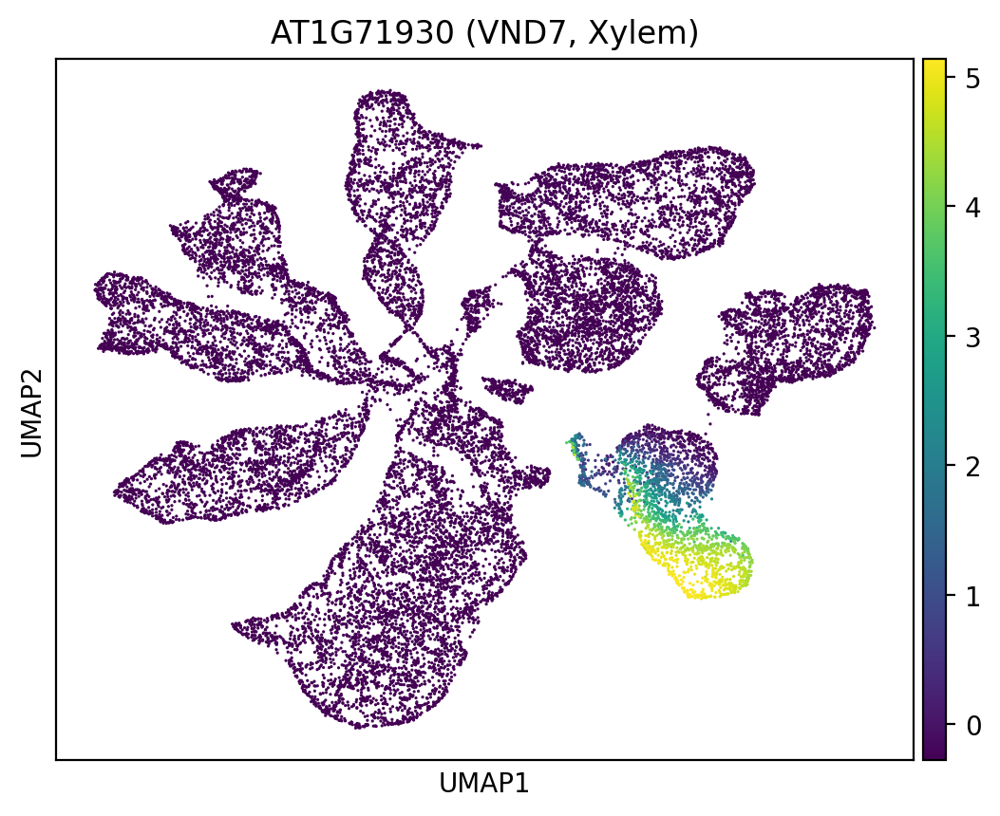

In [25]:
Masked_90 = masked_genes_estimate_recovery(0.9, "./Masked_90_celltype_recovery.csv")

#### Masked 90 replicates

In [30]:
# Run 10 times and collect results
results = [masked_genes_estimate_recovery_simple(0.9) for _ in range(10)]

# Concatenate all results
all_results = pd.concat(results)

# Group by Celltype and compute mean Recovery
mean_recovery = all_results.groupby("Celltype")["Recovery"].mean().reset_index()

print(mean_recovery)

# Save to CSV
mean_recovery.to_csv("./Masked_90_celltype_recovery_10reps.csv", index=False)

            Celltype  Recovery
0       Atrichoblast  0.999586
1          Columella  0.999821
2             Cortex  0.999908
3         Endodermis  0.999954
4   Lateral Root Cap  0.991578
5            Overall  0.997955
6          Pericycle  0.990288
7             Phloem  0.999775
8         Procambium  0.999682
9        Trichoblast  0.999198
10             Xylem  0.999590


#### Masked 95 replicates

In [32]:
# Run 10 times and collect results
results = [masked_genes_estimate_recovery_simple(0.95) for _ in range(10)]

# Concatenate all results
all_results = pd.concat(results)

# Group by Celltype and compute mean Recovery
mean_recovery = all_results.groupby("Celltype")["Recovery"].mean().reset_index()

print(mean_recovery)

# Save to CSV
mean_recovery.to_csv("./Masked_95_celltype_recovery_10reps.csv", index=False)

            Celltype  Recovery
0       Atrichoblast  0.963111
1          Columella  0.971389
2             Cortex  0.994698
3         Endodermis  0.985399
4   Lateral Root Cap  0.719715
5            Overall  0.937686
6          Pericycle  0.888091
7             Phloem  0.960158
8         Procambium  0.962788
9        Trichoblast  0.999322
10             Xylem  0.933096


#### Masked 97 replicates

In [33]:
# Run 10 times and collect results
results = [masked_genes_estimate_recovery_simple(0.97) for _ in range(10)]

# Concatenate all results
all_results = pd.concat(results)

# Group by Celltype and compute mean Recovery
mean_recovery = all_results.groupby("Celltype")["Recovery"].mean().reset_index()

print(mean_recovery)

# Save to CSV
mean_recovery.to_csv("./Masked_97_celltype_recovery_10reps.csv", index=False)

            Celltype  Recovery
0       Atrichoblast  0.846210
1          Columella  0.589939
2             Cortex  0.945541
3         Endodermis  0.787704
4   Lateral Root Cap  0.172369
5            Overall  0.705195
6          Pericycle  0.545231
7             Phloem  0.797662
8         Procambium  0.729019
9        Trichoblast  0.999634
10             Xylem  0.632470


#### Masked 99 replicates

In [34]:
# Run 10 times and collect results
results = [masked_genes_estimate_recovery_simple(0.99) for _ in range(10)]

# Concatenate all results
all_results = pd.concat(results)

# Group by Celltype and compute mean Recovery
mean_recovery = all_results.groupby("Celltype")["Recovery"].mean().reset_index()

print(mean_recovery)

# Save to CSV
mean_recovery.to_csv("./Masked_99_celltype_recovery_10reps.csv", index=False)

            Celltype  Recovery
0       Atrichoblast  0.154654
1          Columella  0.002458
2             Cortex  0.301900
3         Endodermis  0.053465
4   Lateral Root Cap  0.000000
5            Overall  0.165468
6          Pericycle  0.018231
7             Phloem  0.048423
8         Procambium  0.034656
9        Trichoblast  0.999167
10             Xylem  0.045894


#### Masked all replicates

In [35]:
# Run 10 times and collect results
results = [masked_genes_estimate_recovery_simple(1) for _ in range(10)]

# Concatenate all results
all_results = pd.concat(results)

# Group by Celltype and compute mean Recovery
mean_recovery = all_results.groupby("Celltype")["Recovery"].mean().reset_index()

print(mean_recovery)

# Save to CSV
mean_recovery.to_csv("./Masked_100_celltype_recovery_10reps.csv", index=False)

            Celltype  Recovery
0       Atrichoblast  0.000000
1          Columella  0.000000
2             Cortex  0.000000
3         Endodermis  0.000000
4   Lateral Root Cap  0.000000
5            Overall  0.100536
6          Pericycle  0.000000
7             Phloem  0.000000
8         Procambium  0.000000
9        Trichoblast  1.000000
10             Xylem  0.000000


            Celltype  Recovery
0            Overall  0.944818
1          Columella  0.986790
2   Lateral Root Cap  0.707216
3             Phloem  0.994638
4              Xylem  0.976776
5         Procambium  0.991758
6          Pericycle  0.863192
7         Endodermis  0.959510
8             Cortex  0.998626
9       Atrichoblast  0.962833
10       Trichoblast  0.999093


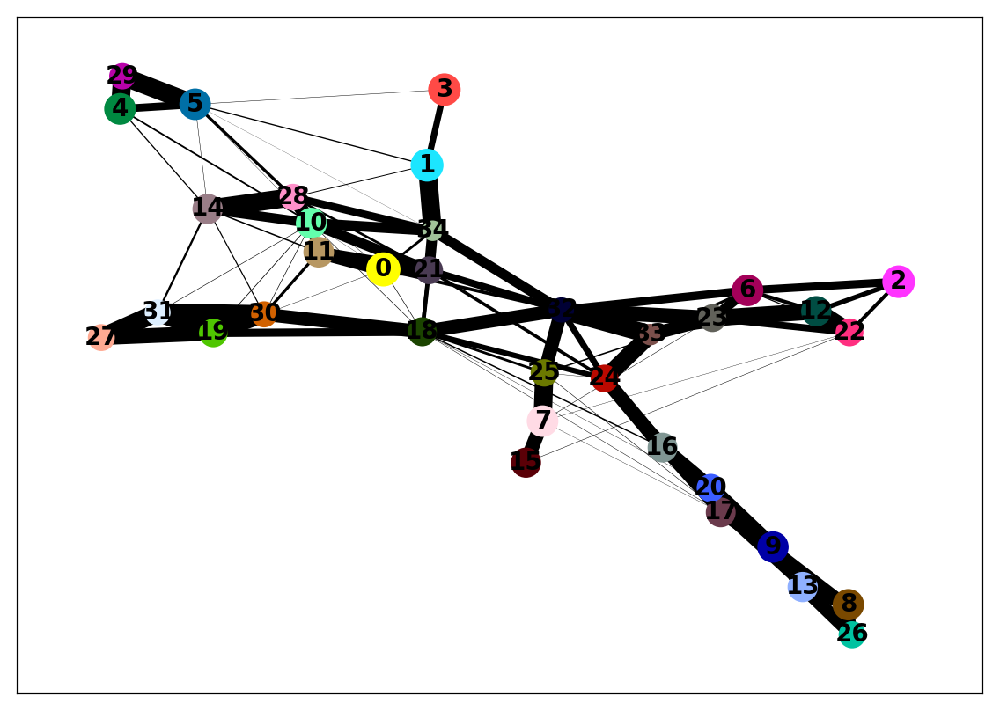

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


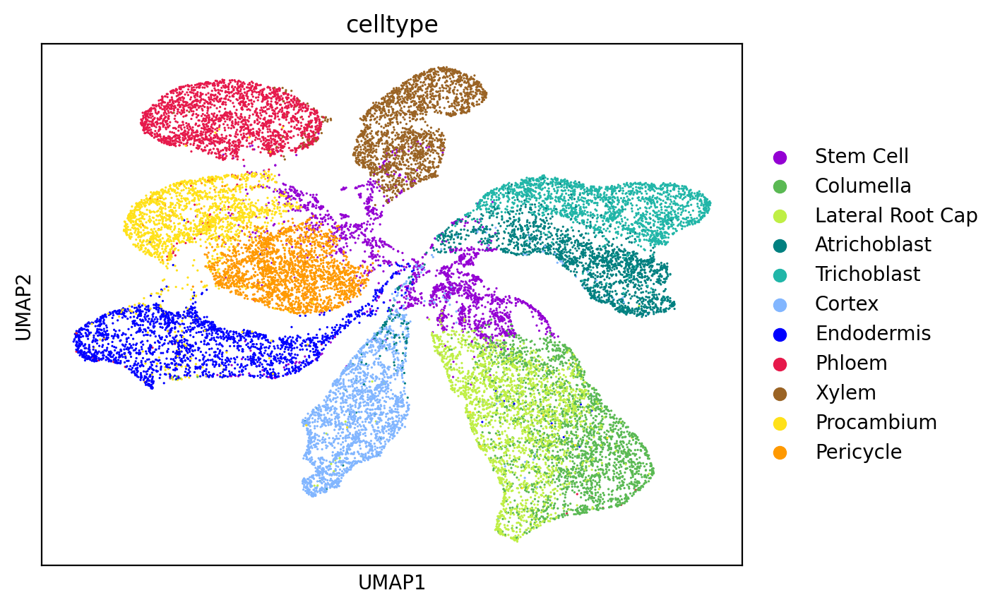

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


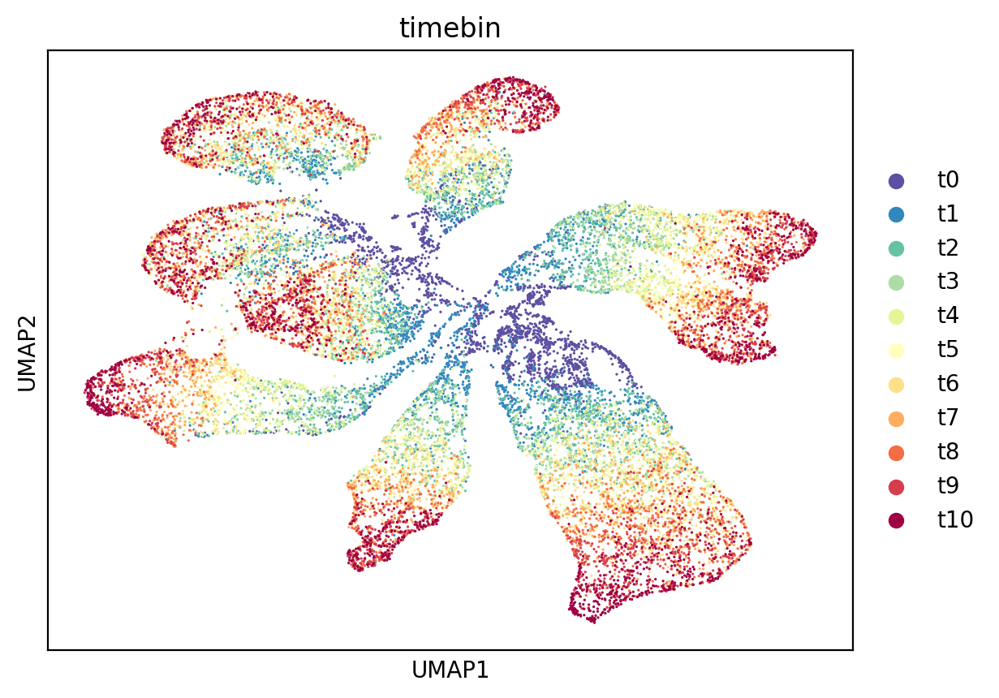

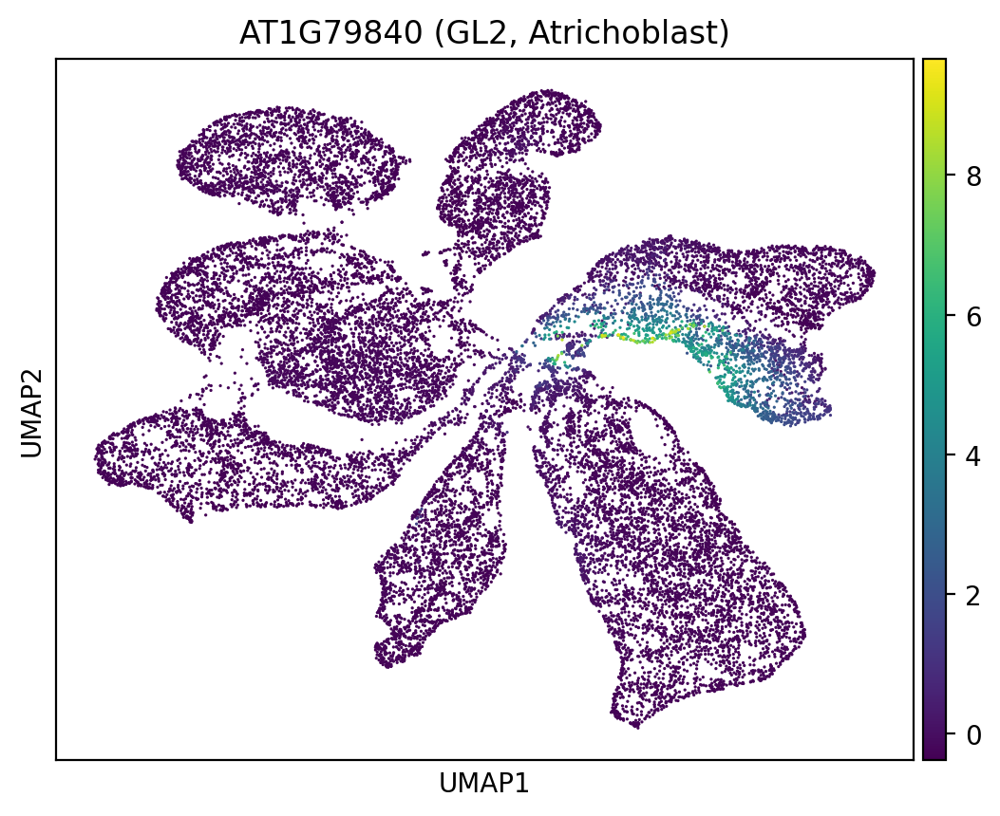

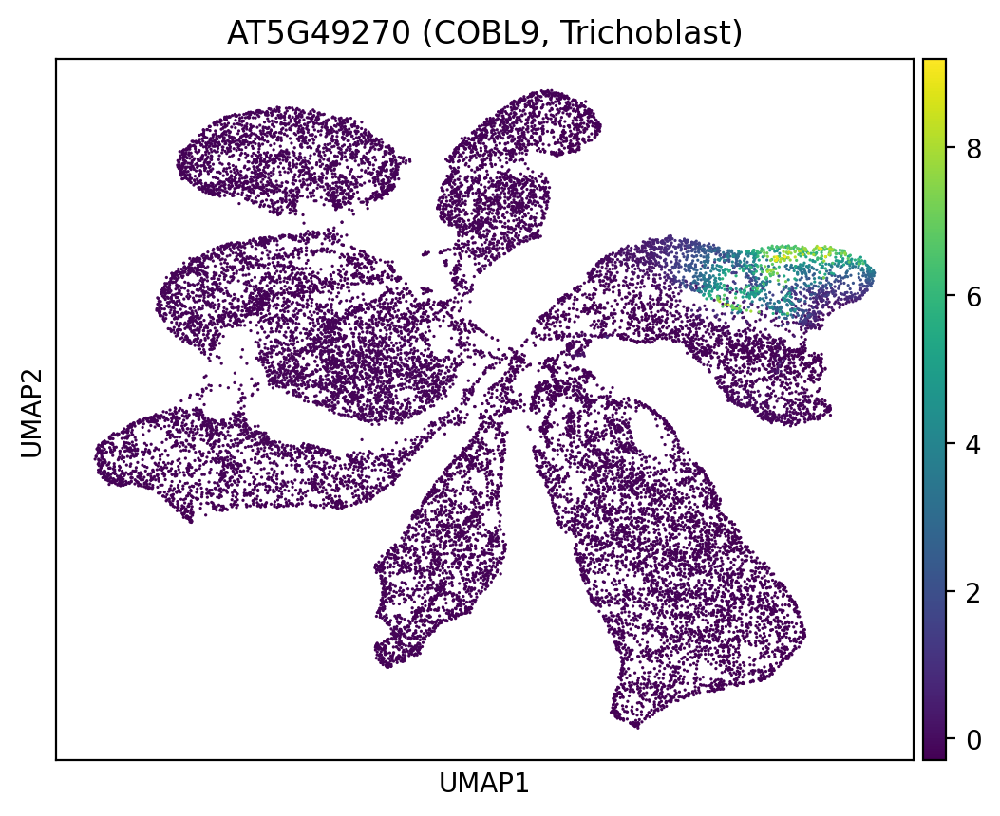

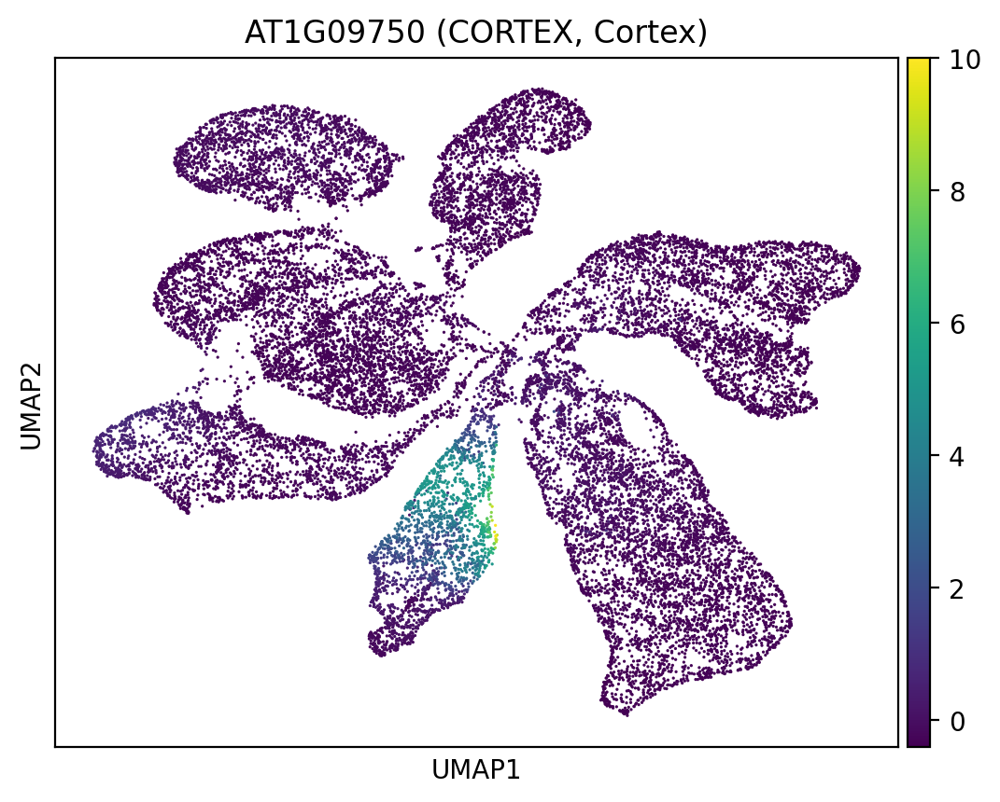

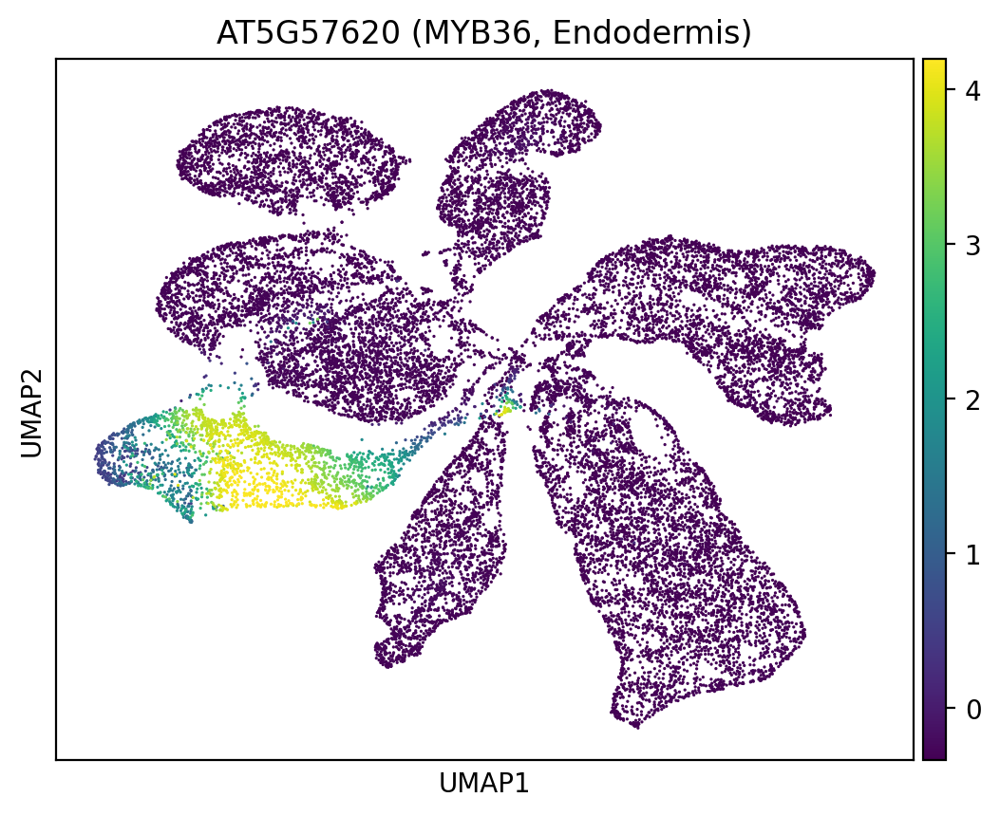

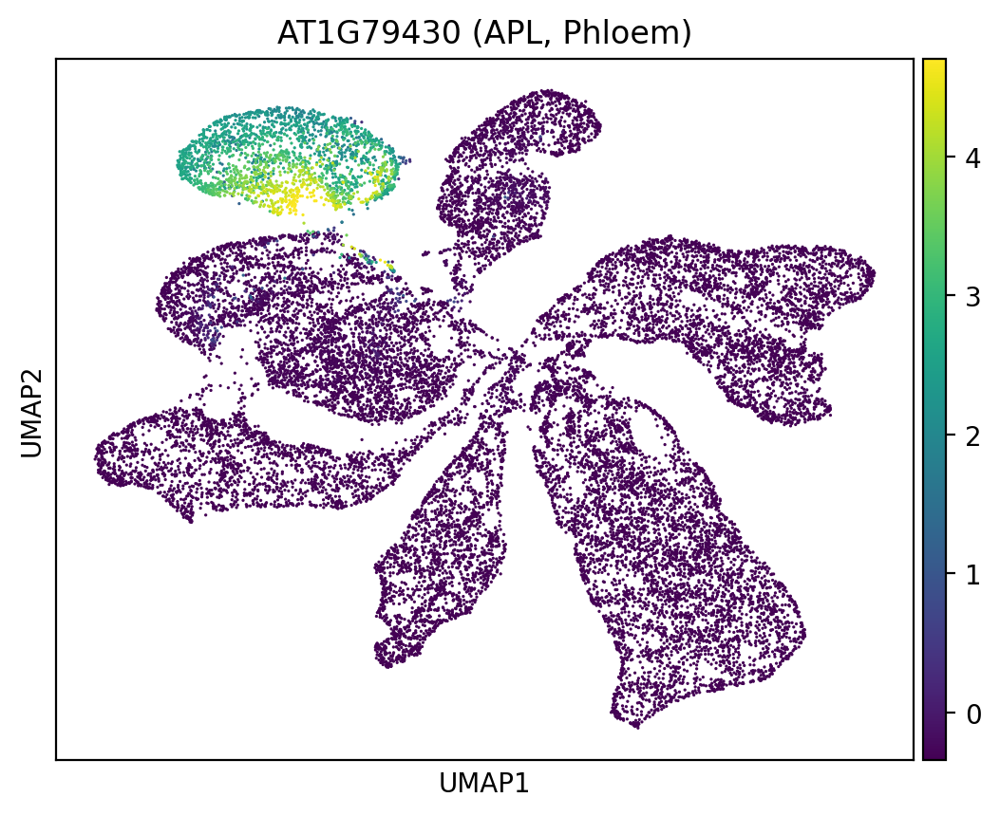

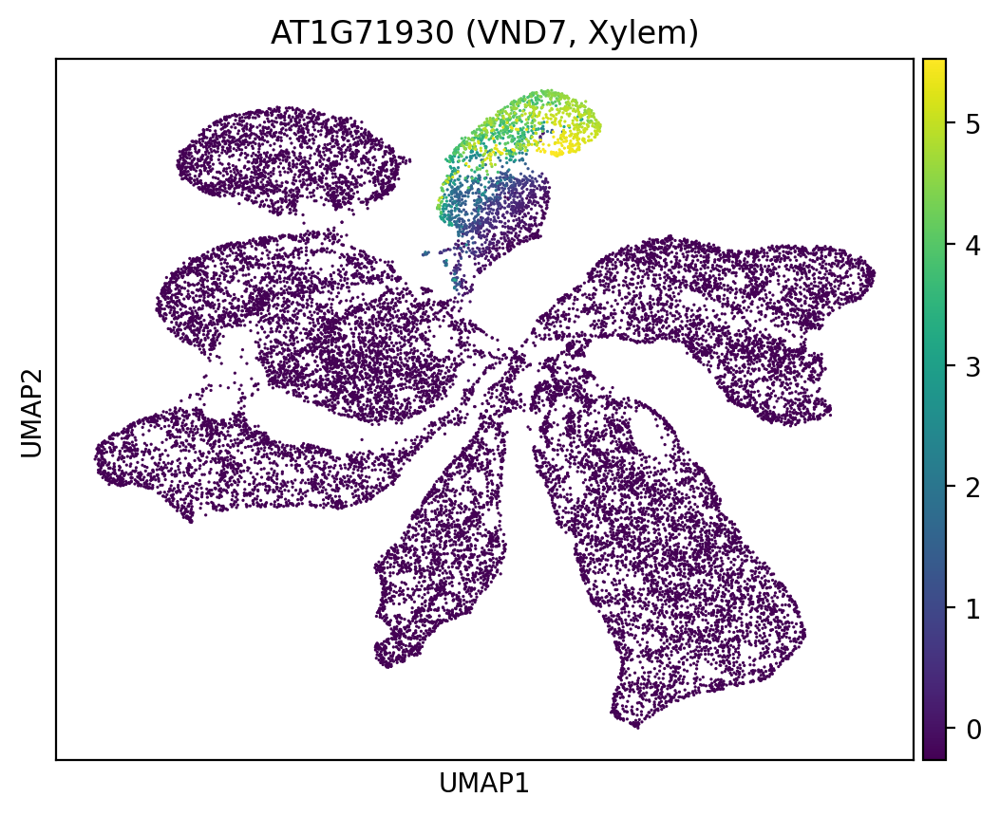

In [26]:
## 876 genes
Masked_95 = masked_genes_estimate_recovery(0.95, "./Masked_95_celltype_recovery.csv")

            Celltype  Recovery
0            Overall  0.712727
1          Columella  0.591810
2   Lateral Root Cap  0.131822
3             Phloem  0.899464
4              Xylem  0.709016
5         Procambium  0.789377
6          Pericycle  0.612378
7         Endodermis  0.669962
8             Cortex  0.915293
9       Atrichoblast  0.794491
10       Trichoblast  0.998639


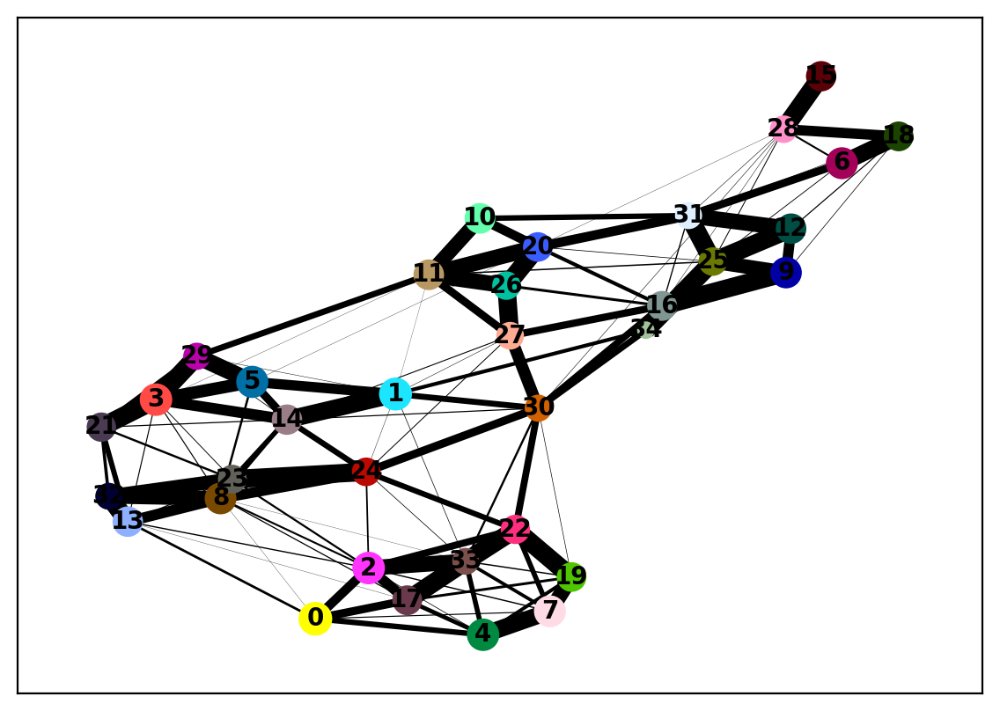

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


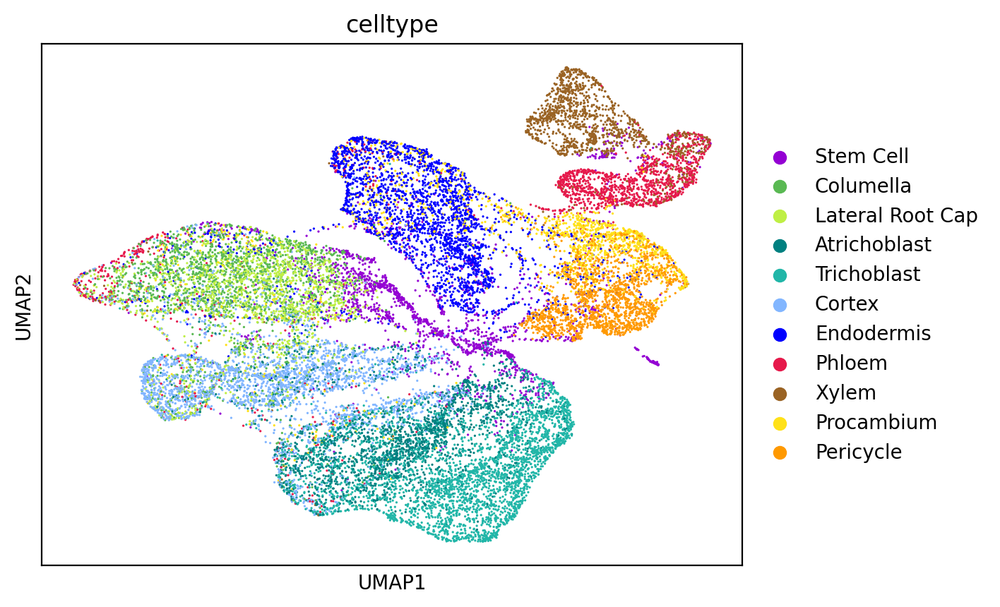

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


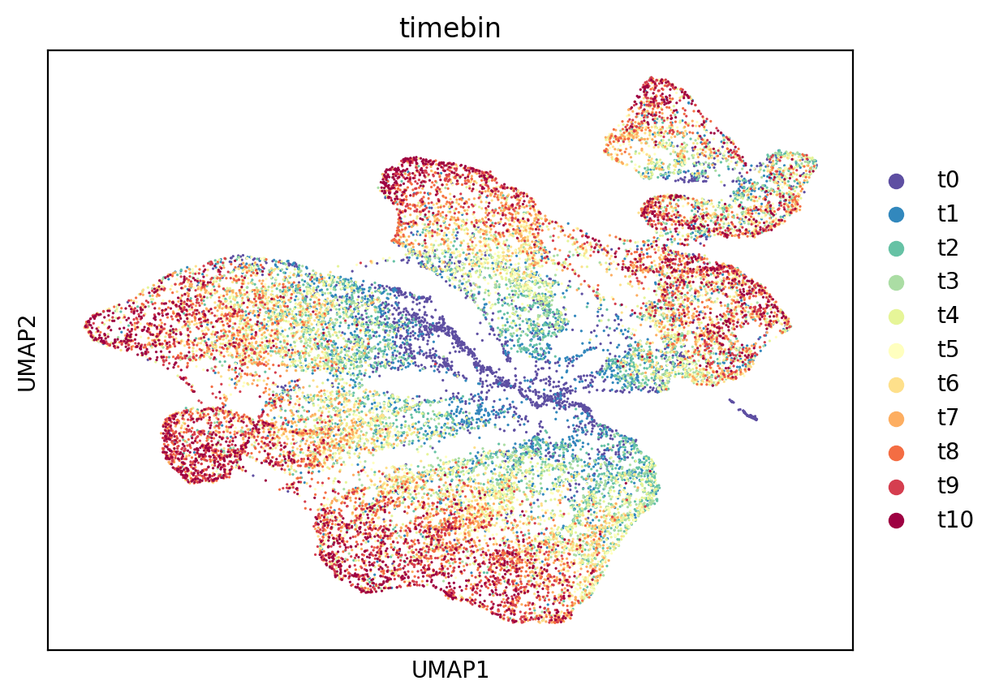

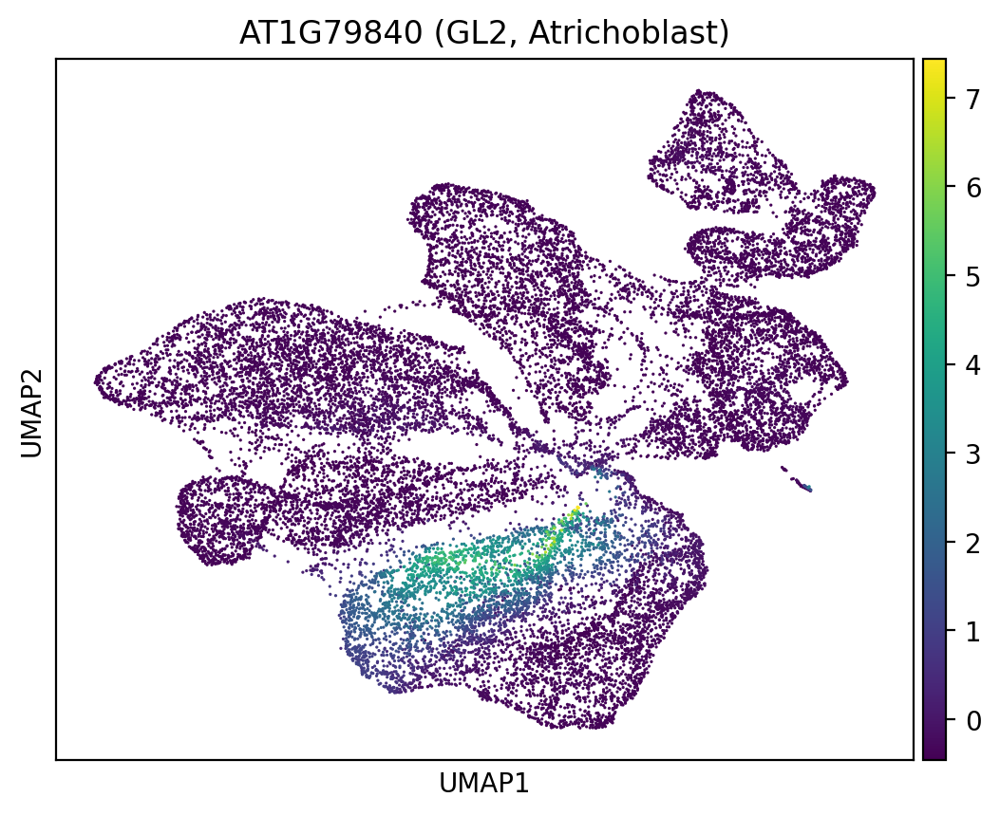

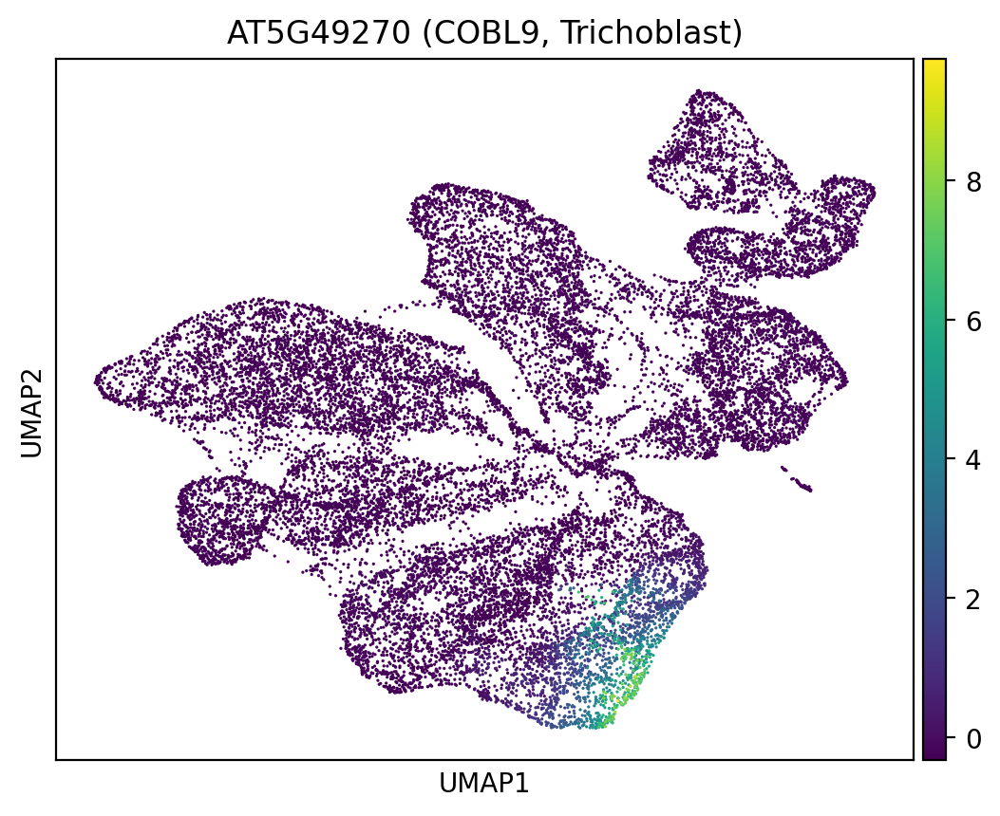

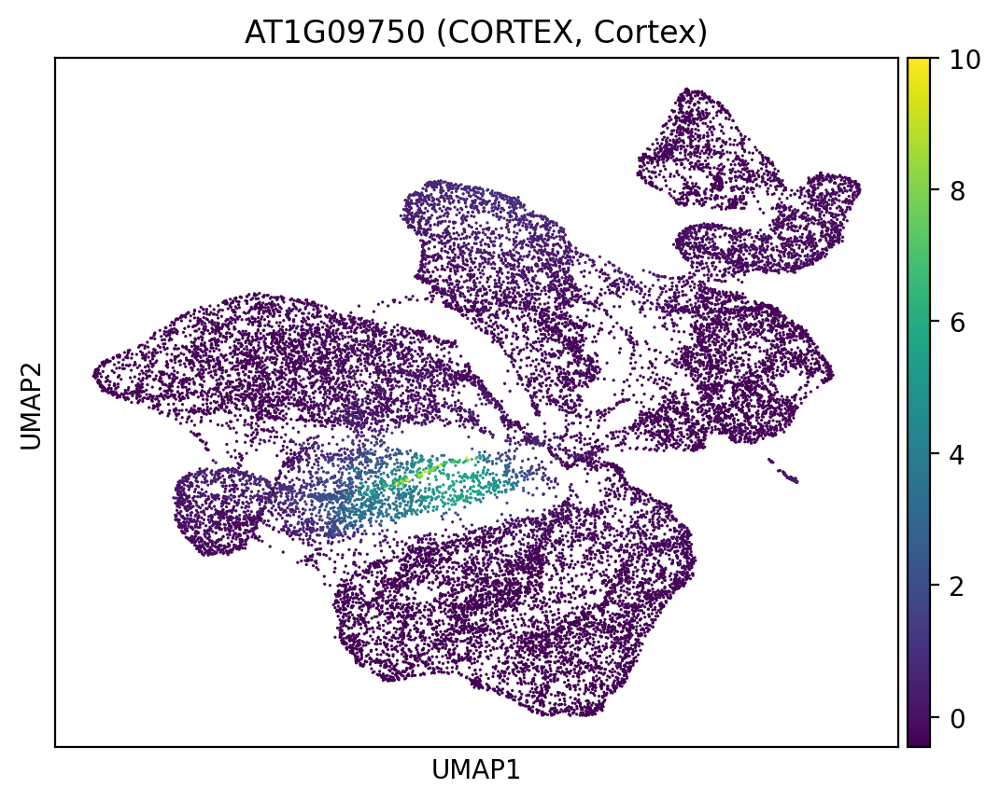

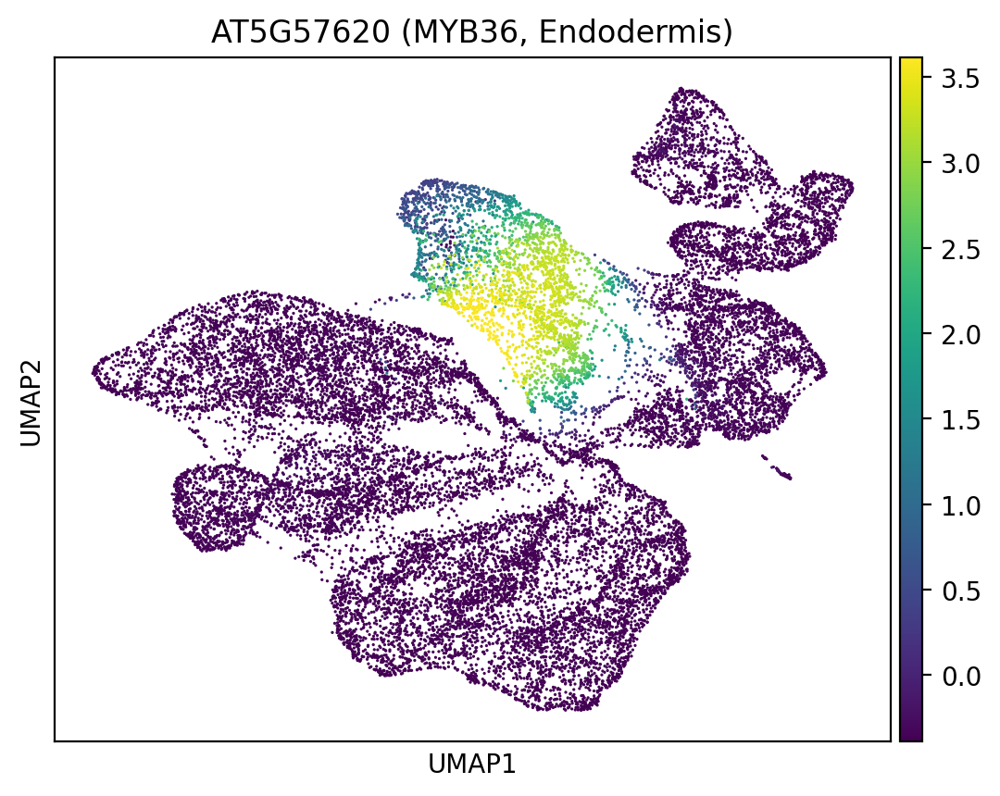

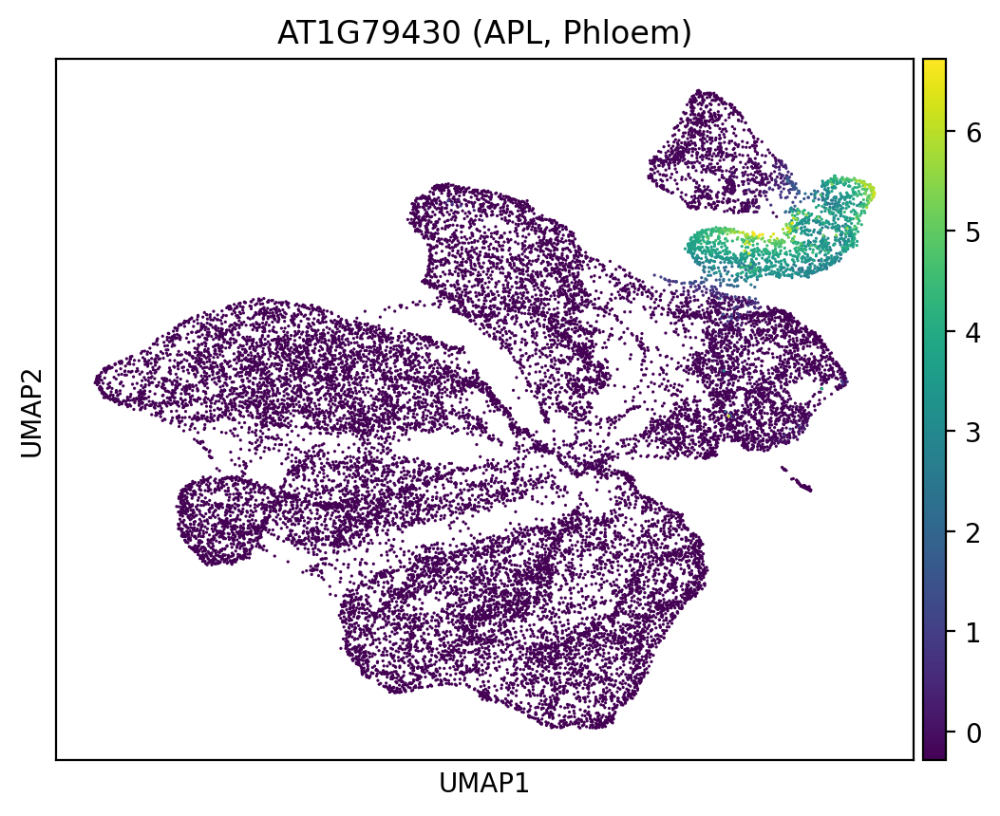

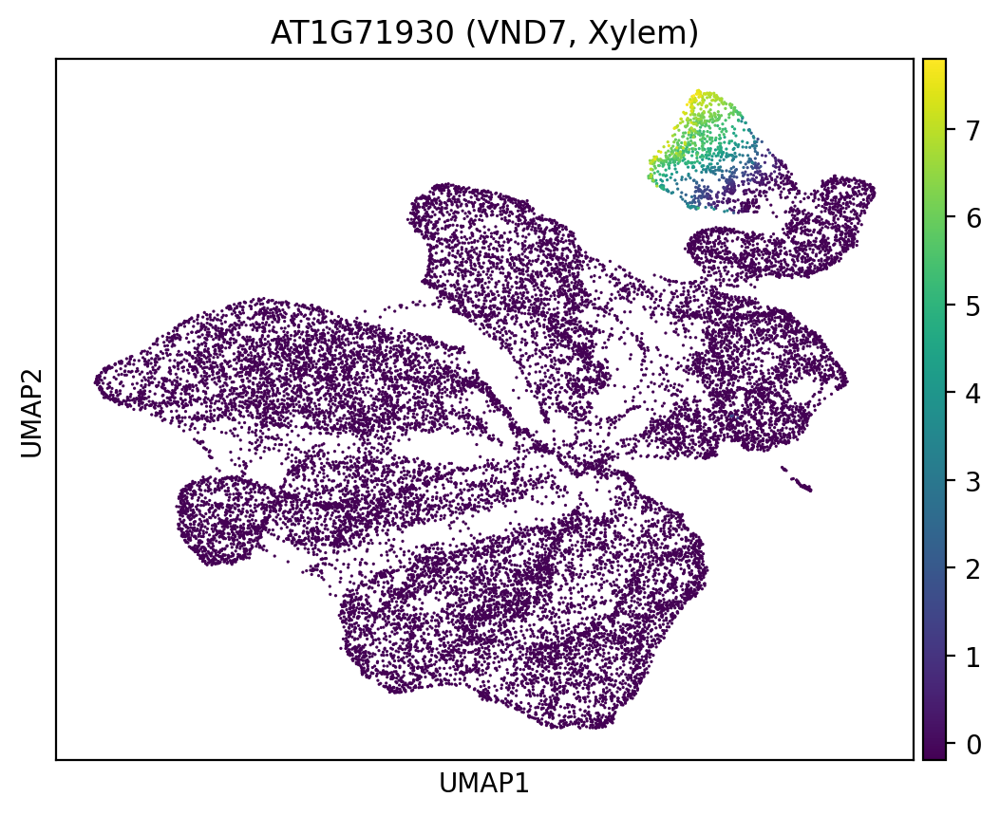

In [27]:
## 525 genes
Masked_97 = masked_genes_estimate_recovery(0.97, "./Masked_97_celltype_recovery.csv")

            Celltype  Recovery
0            Overall  0.138273
1          Columella  0.000000
2   Lateral Root Cap  0.000000
3             Phloem  0.042895
4              Xylem  0.000911
5         Procambium  0.013736
6          Pericycle  0.022336
7         Endodermis  0.013183
8             Cortex  0.217491
9       Atrichoblast  0.069086
10       Trichoblast  1.000000


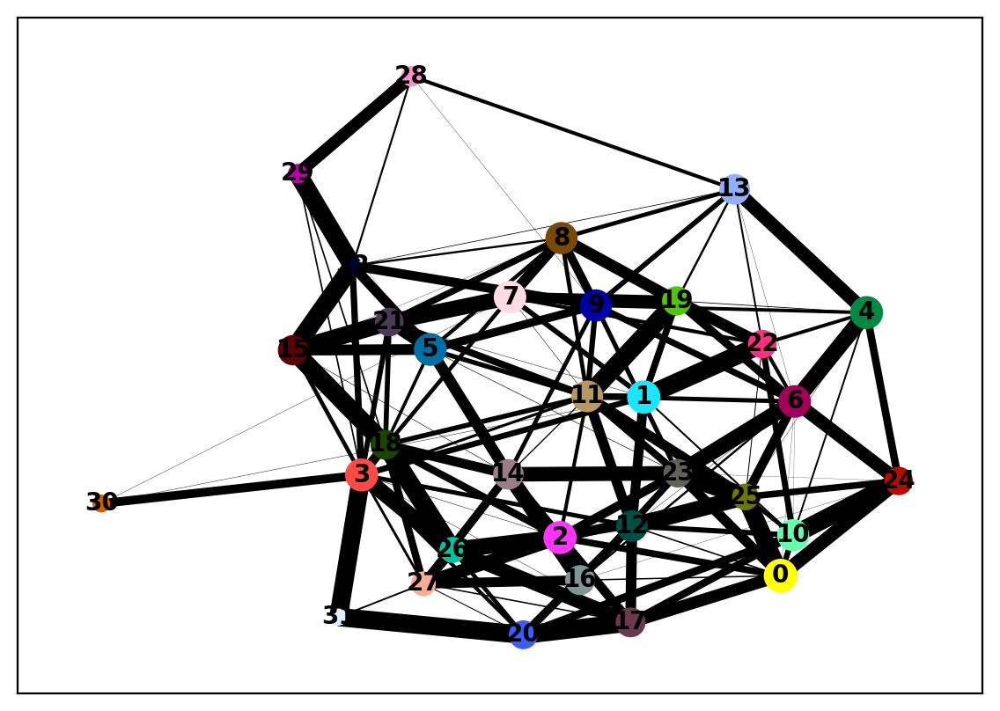

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


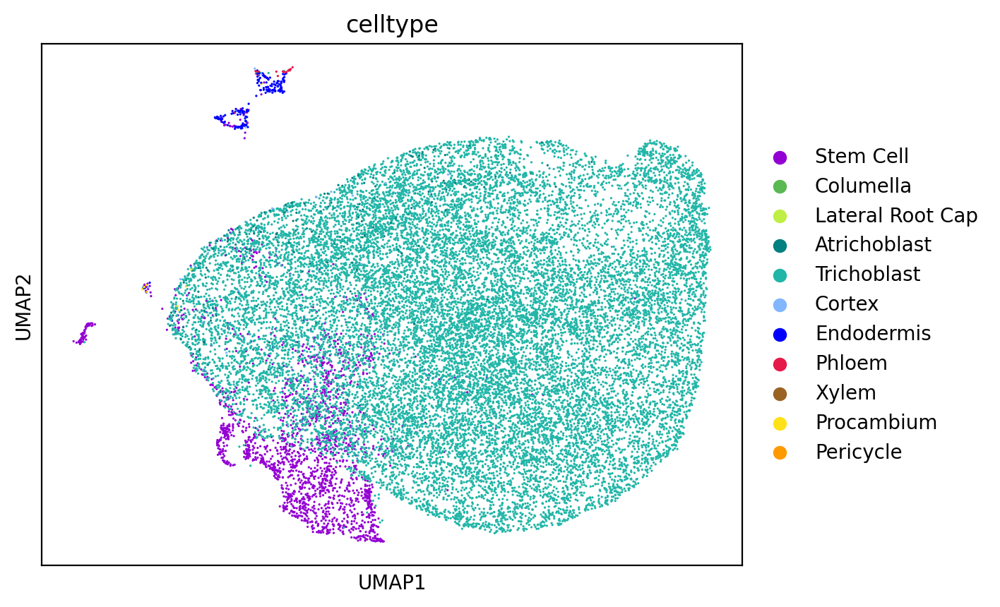

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


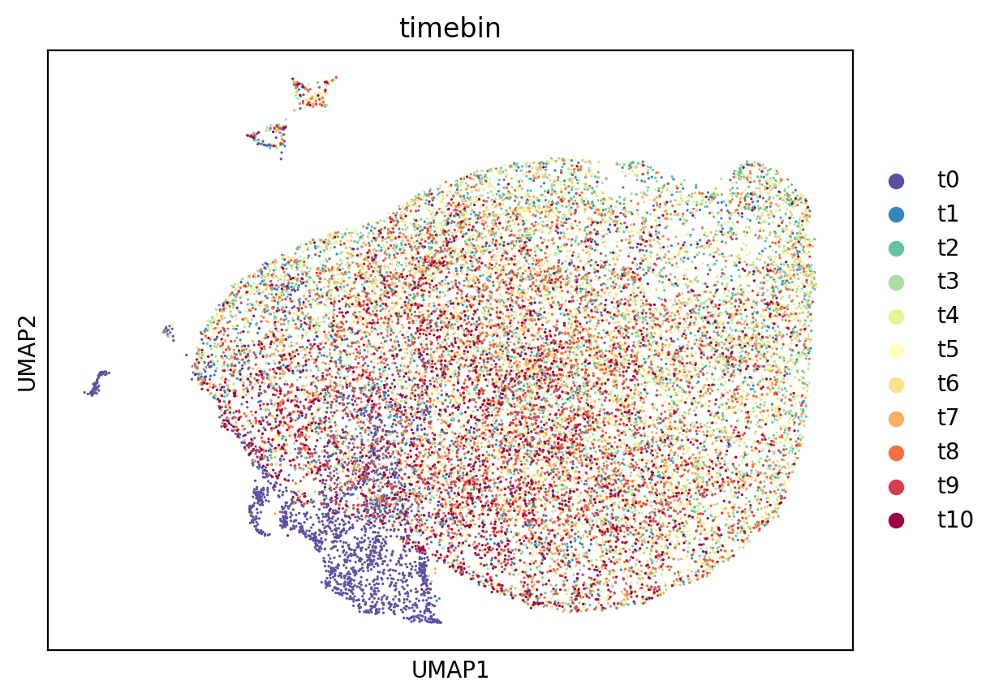

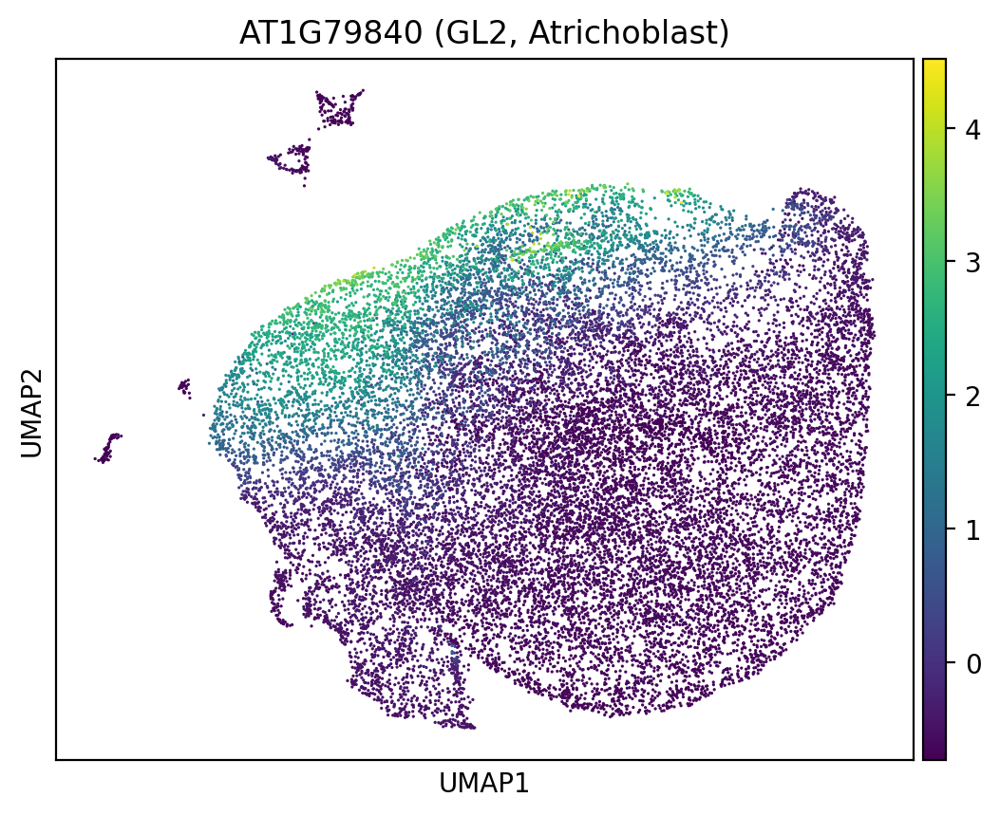

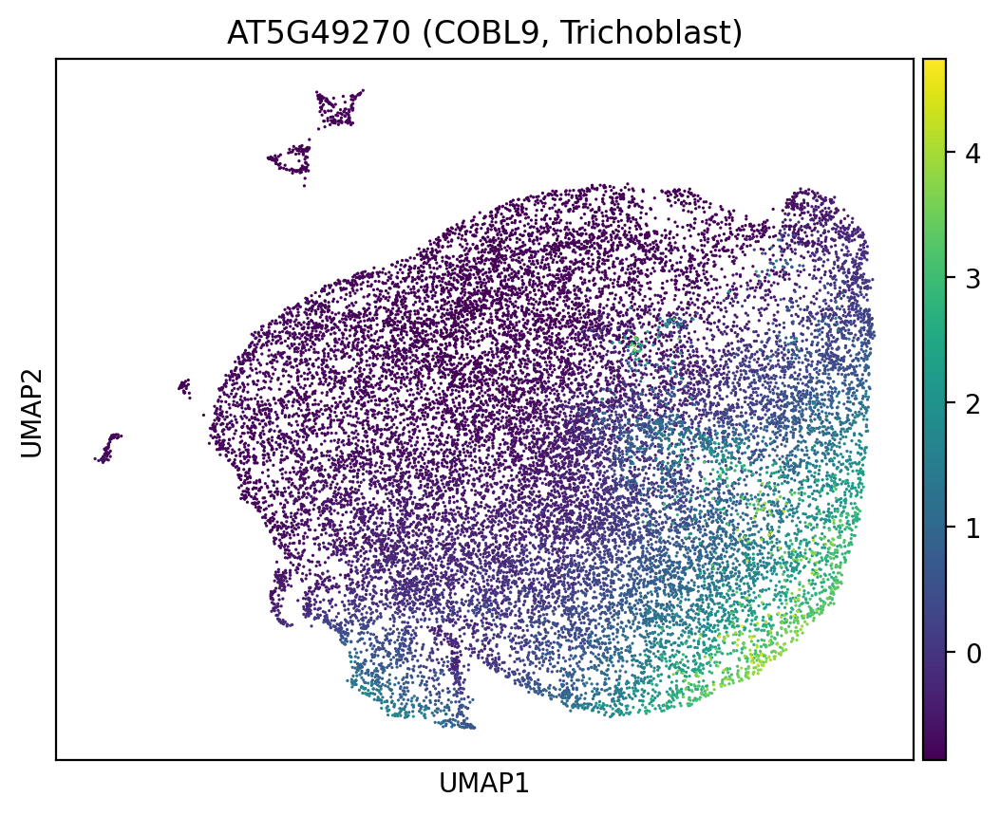

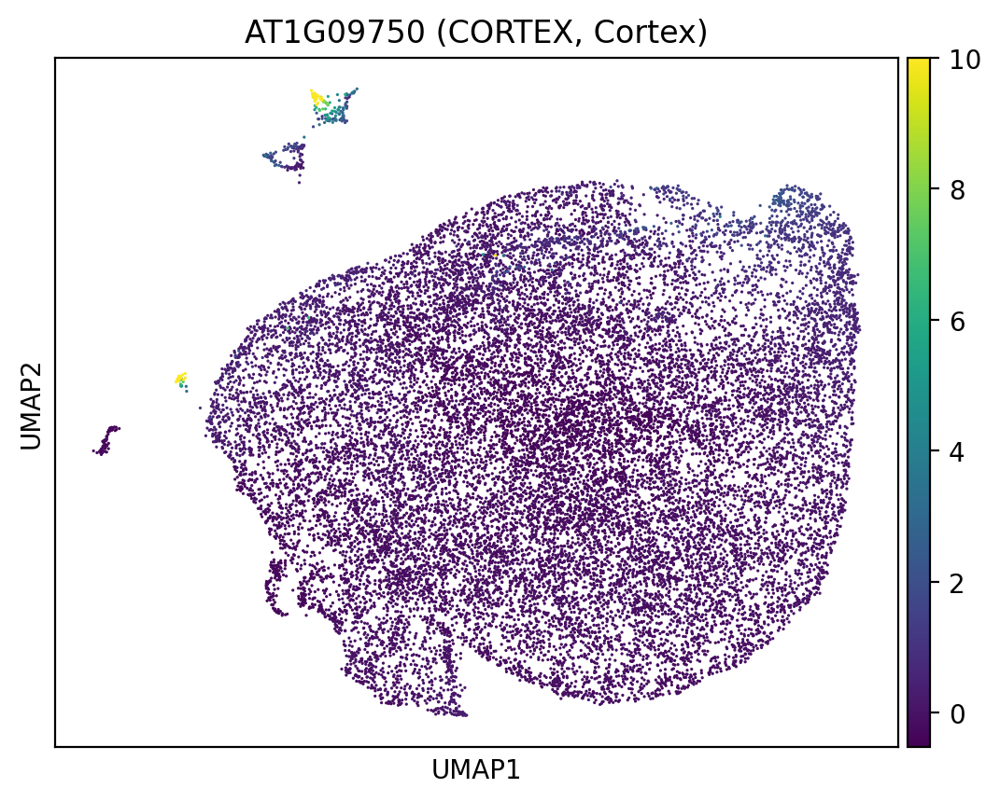

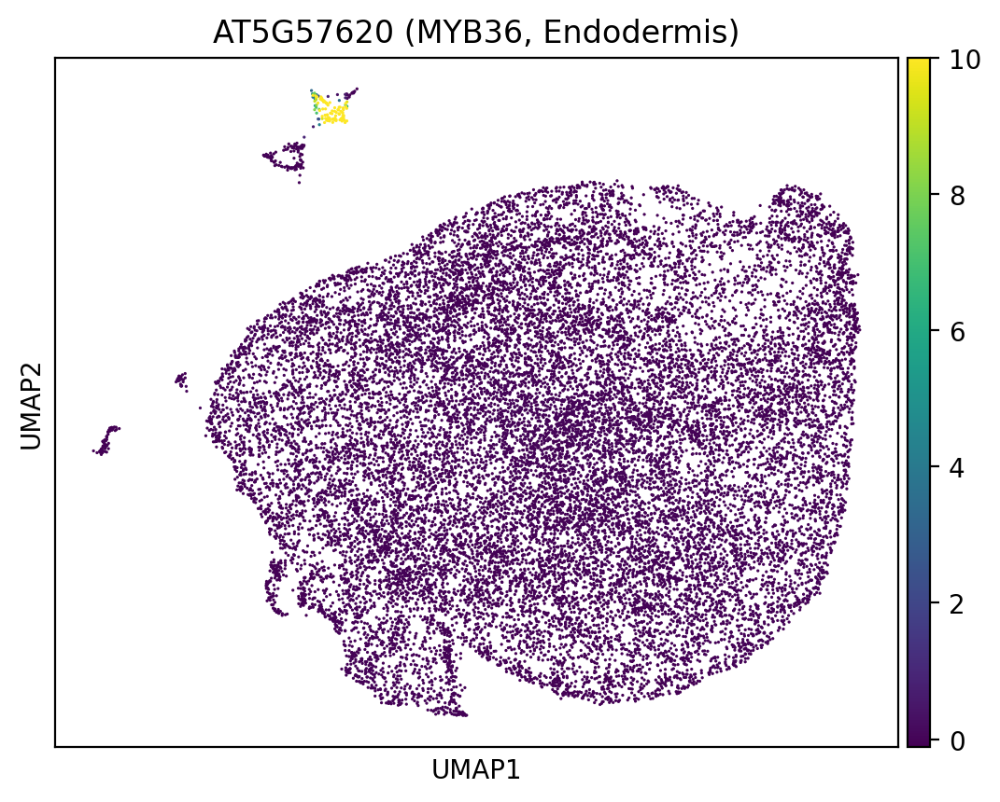

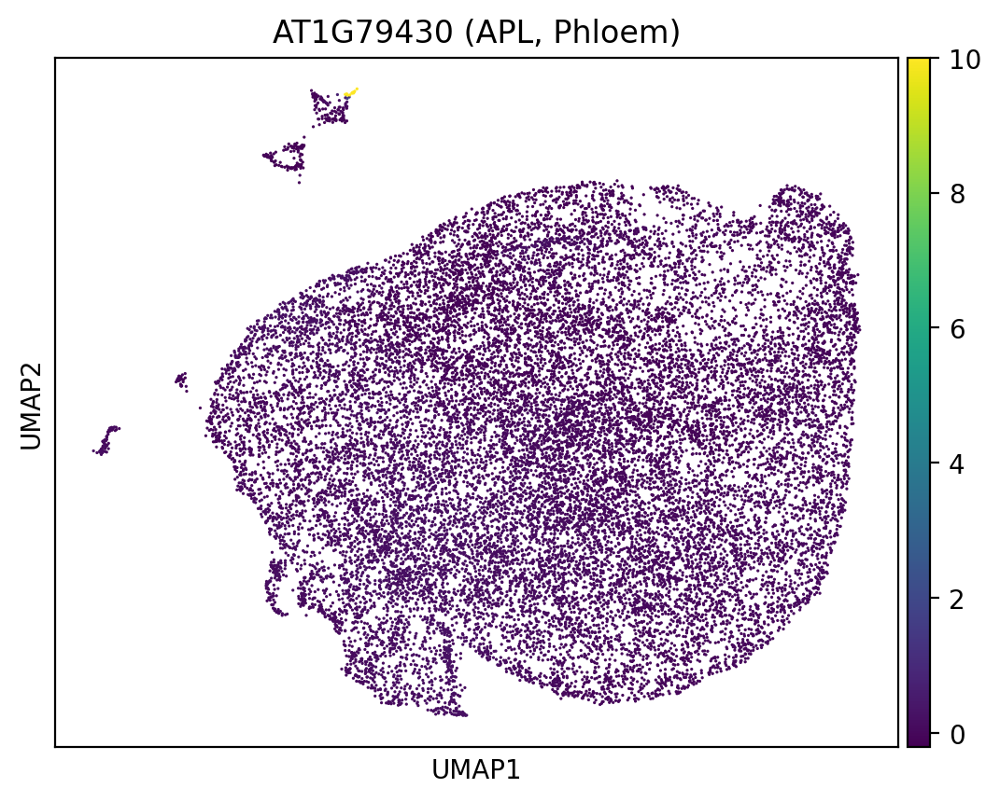

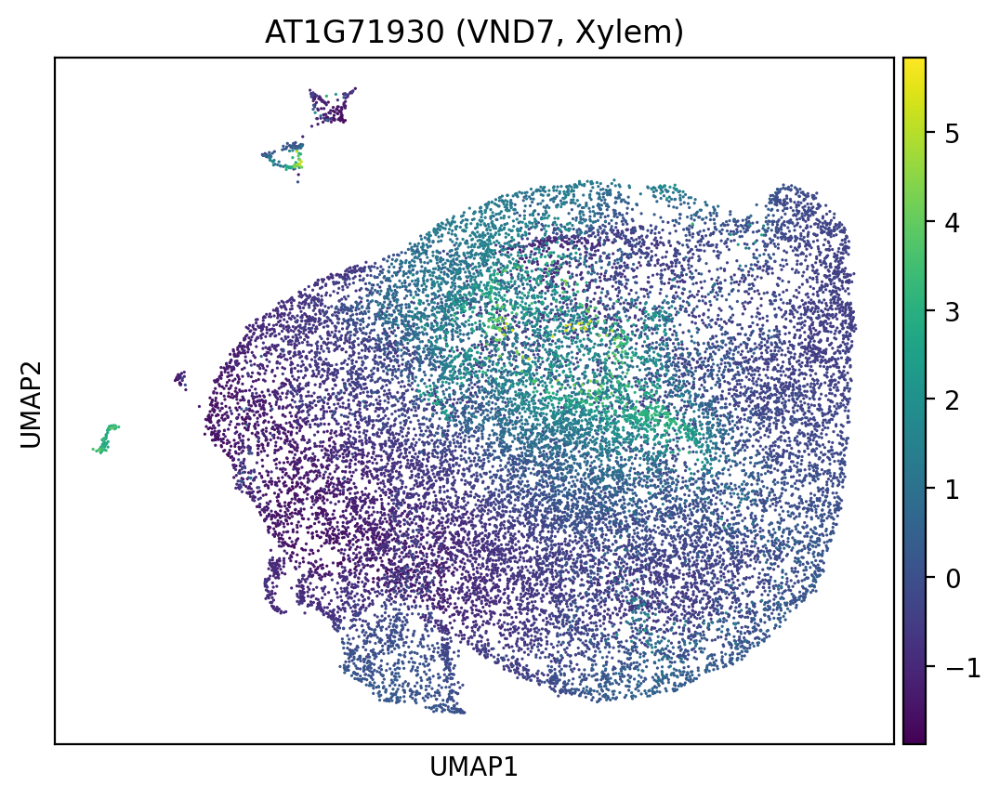

In [28]:
## 175 genes
Masked_99 = masked_genes_estimate_recovery(0.99, "./Masked_99_celltype_recovery.csv")

            Celltype  Recovery
0            Overall  0.110864
1          Columella  0.000000
2   Lateral Root Cap  0.000000
3             Phloem  0.000000
4              Xylem  0.000000
5         Procambium  0.000000
6          Pericycle  0.003257
7         Endodermis  0.000000
8             Cortex  0.064560
9       Atrichoblast  0.037604
10       Trichoblast  1.000000


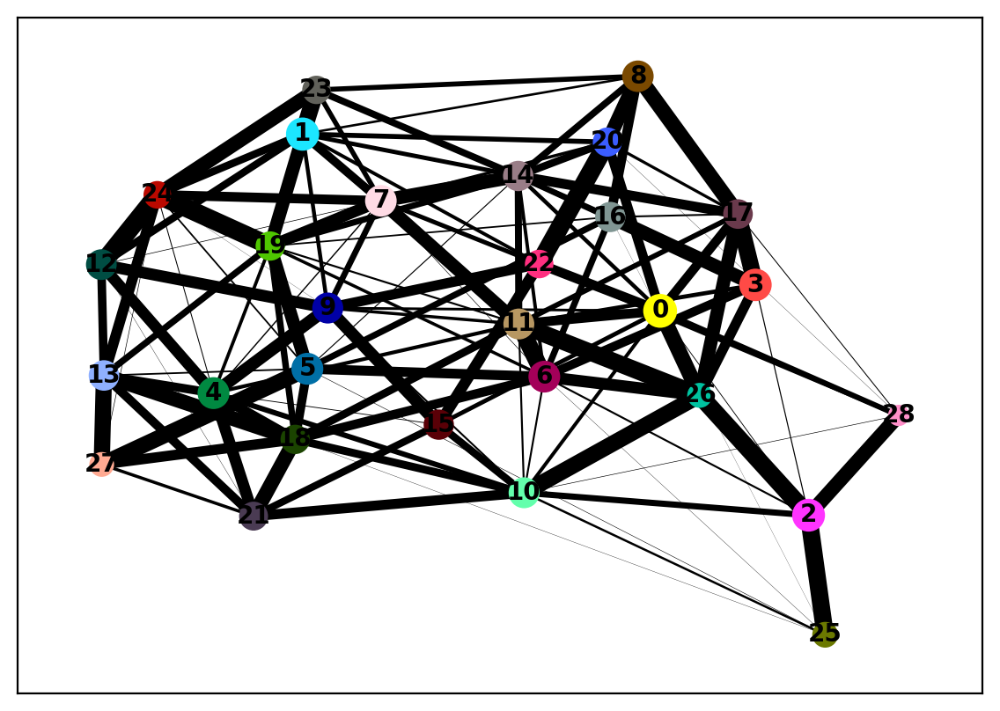

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


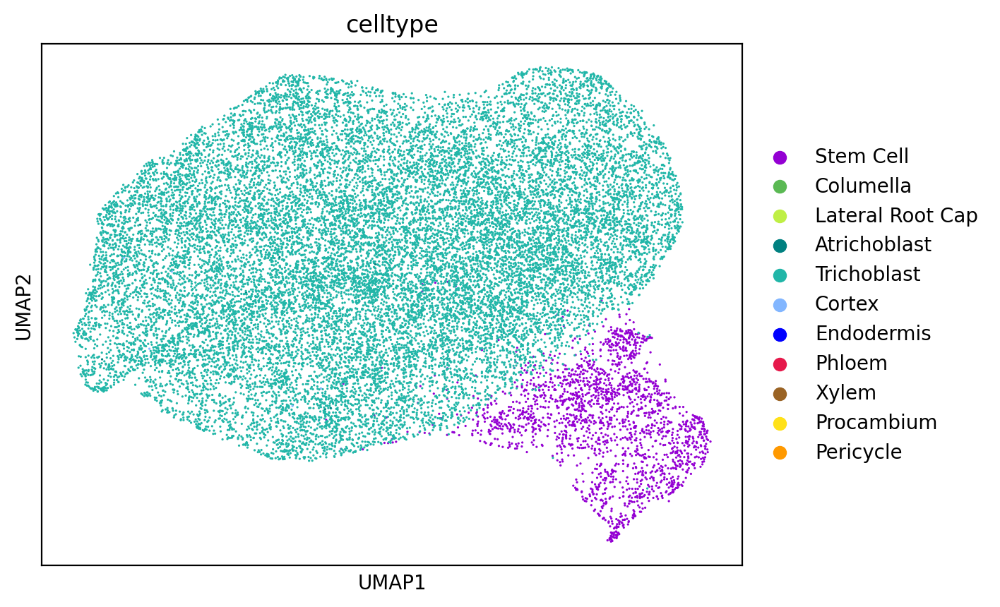

/hpc/group/pbenfeylab/ch416/miniconda3/envs/genesys/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


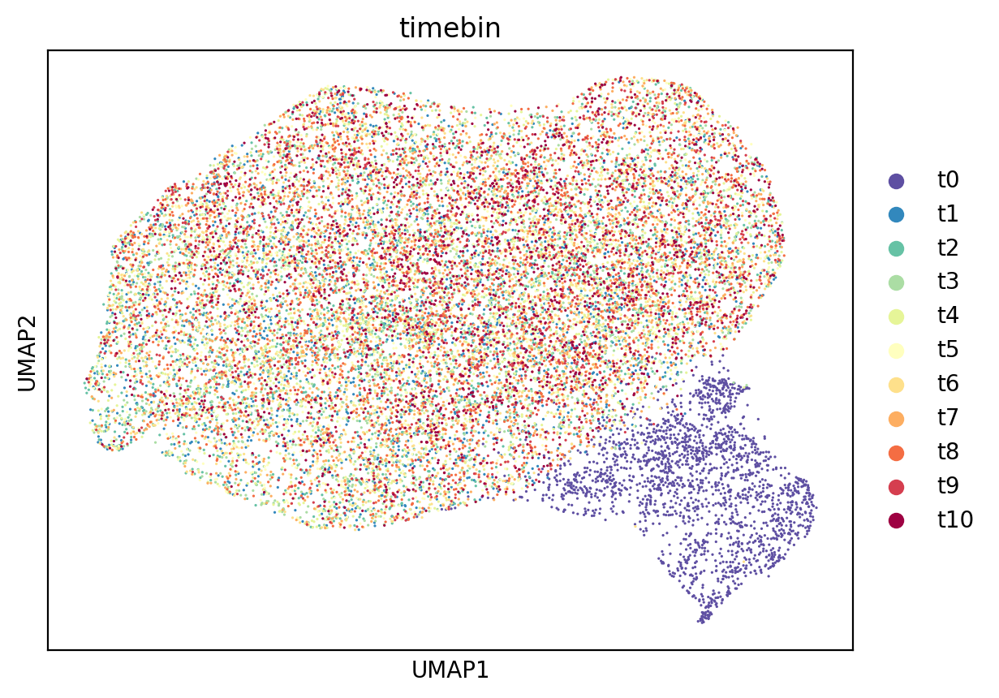

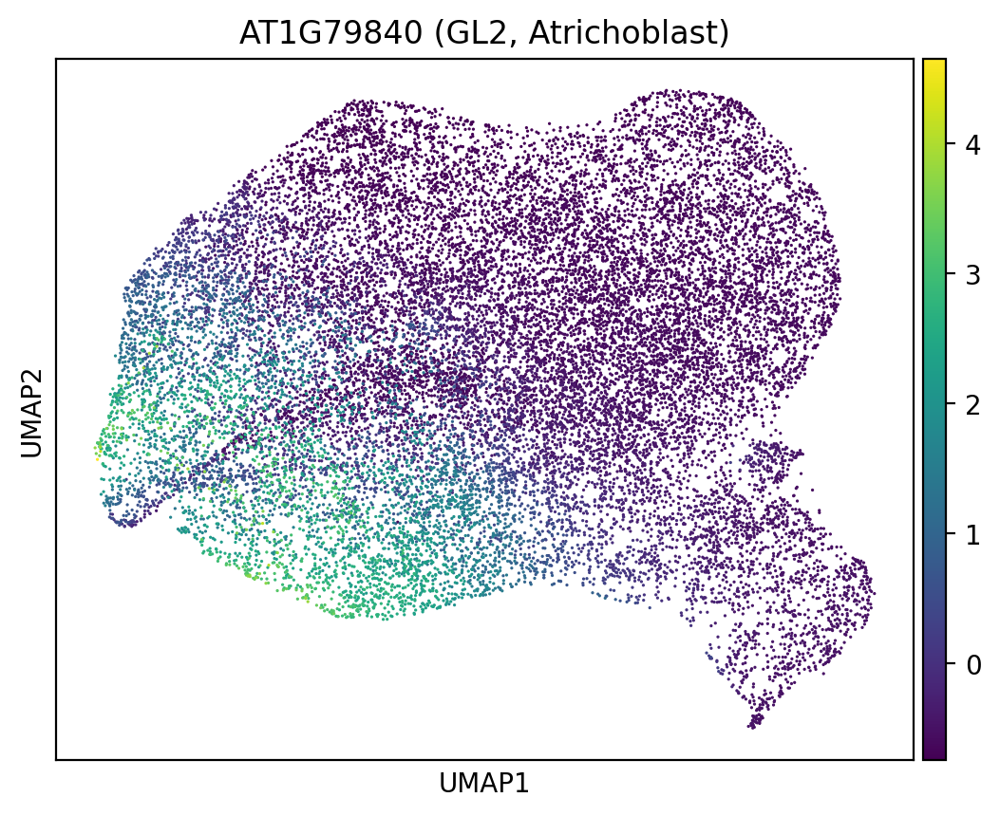

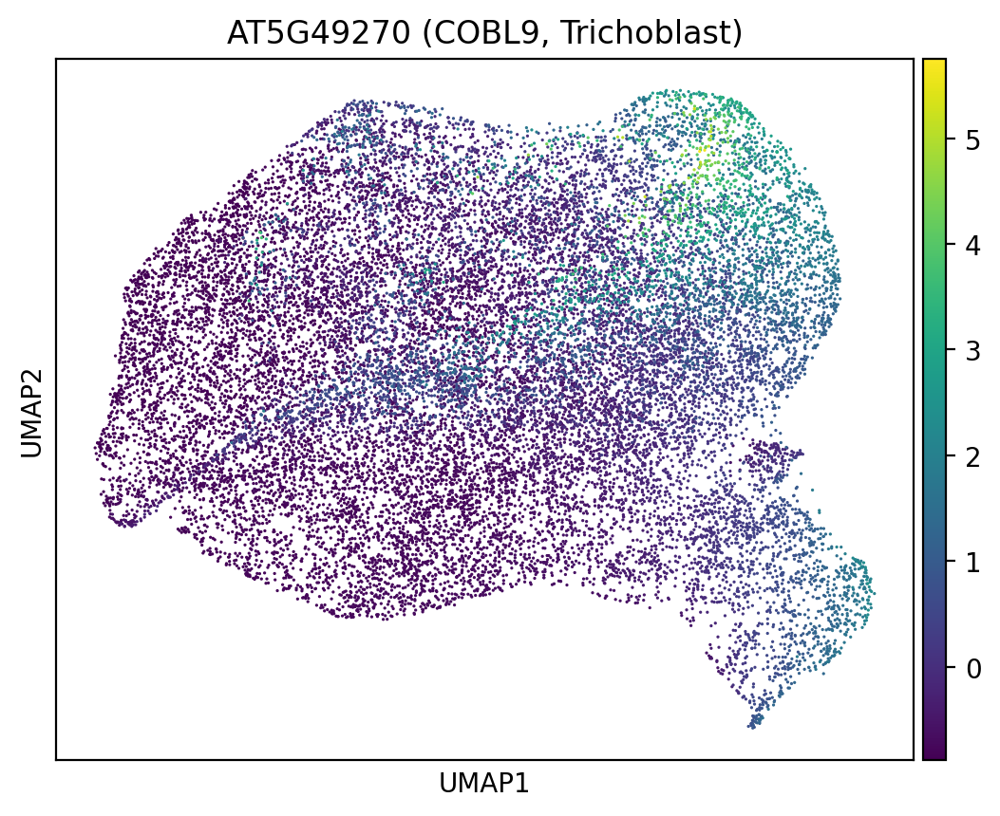

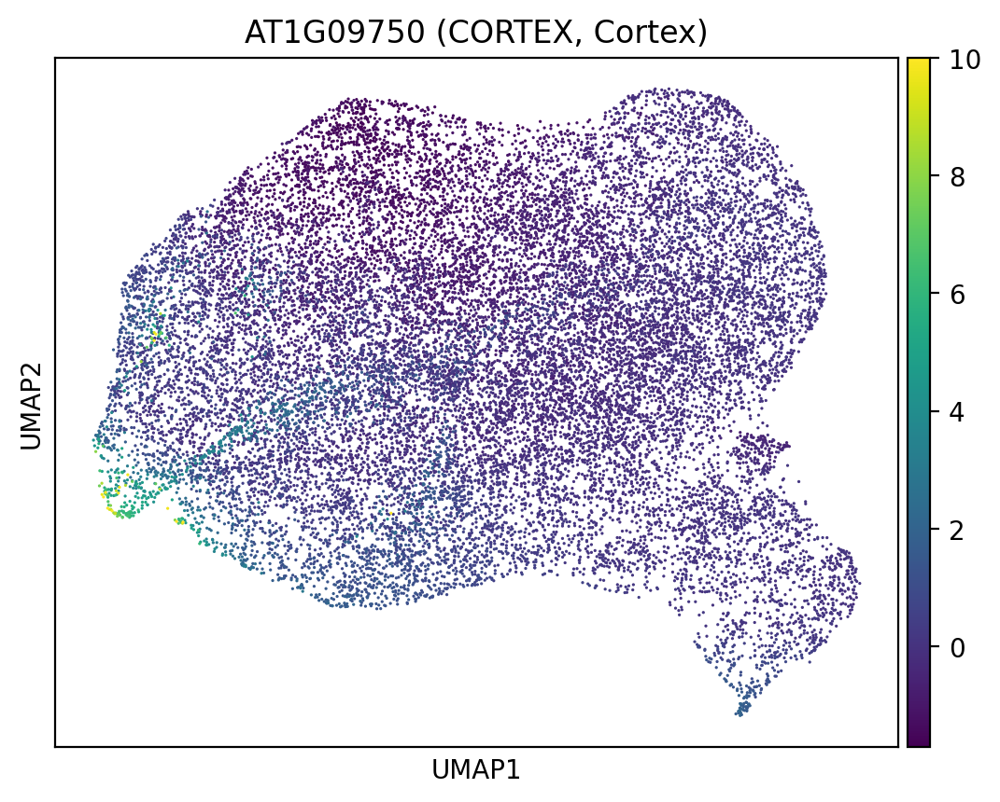

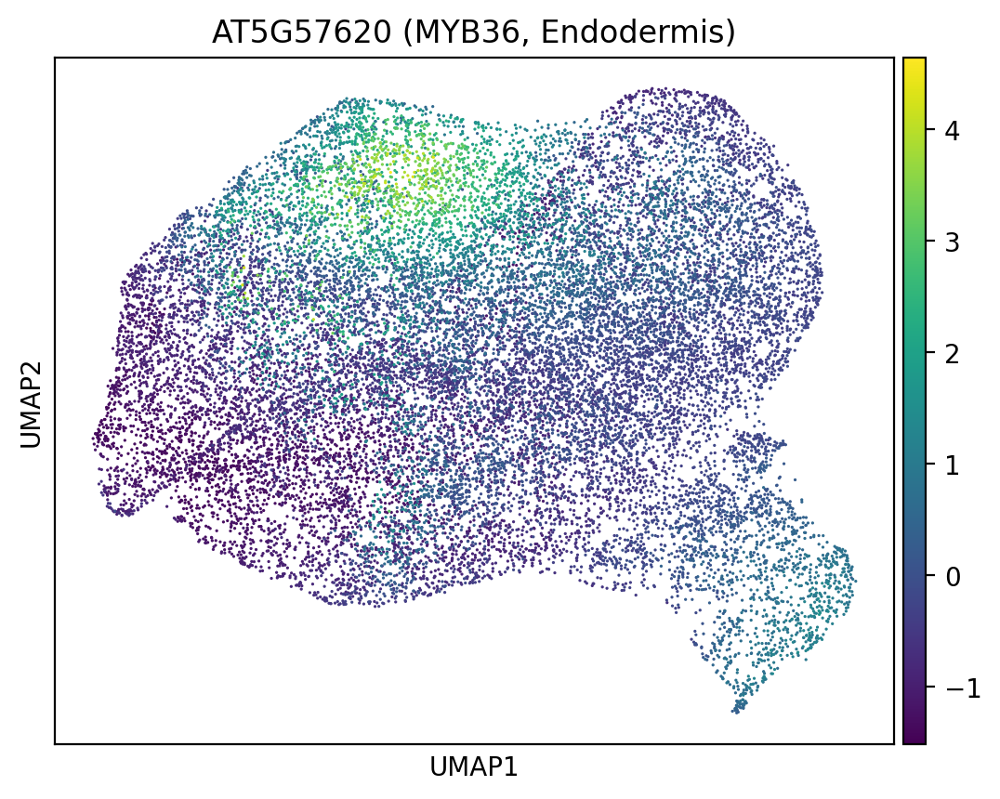

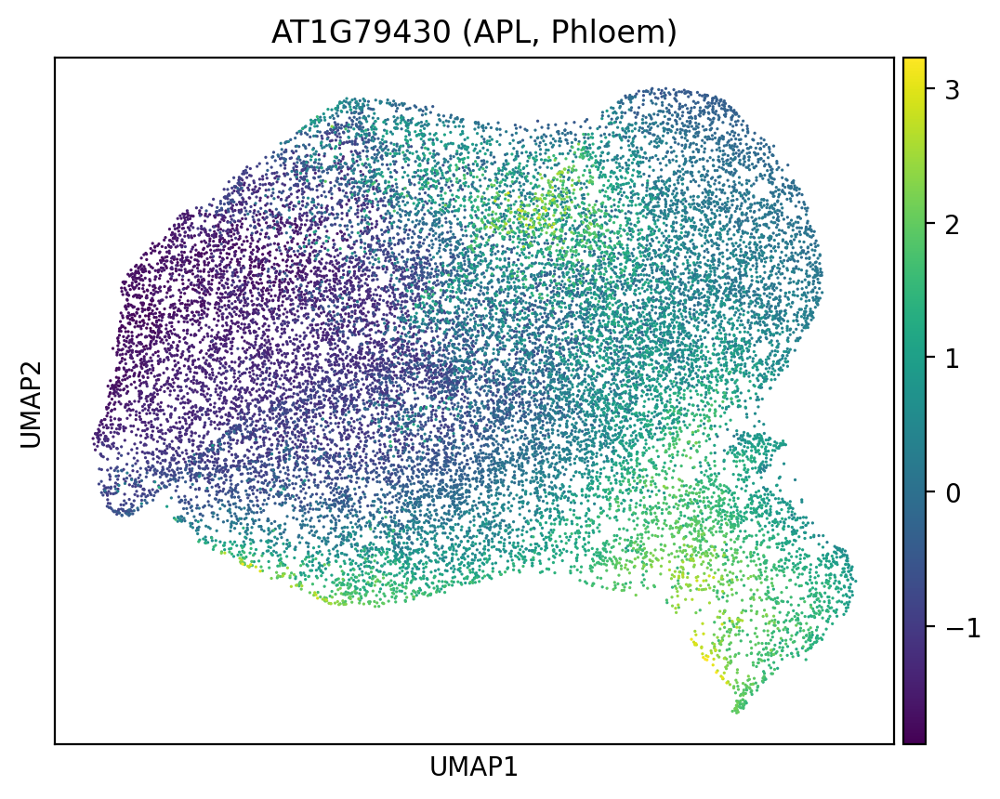

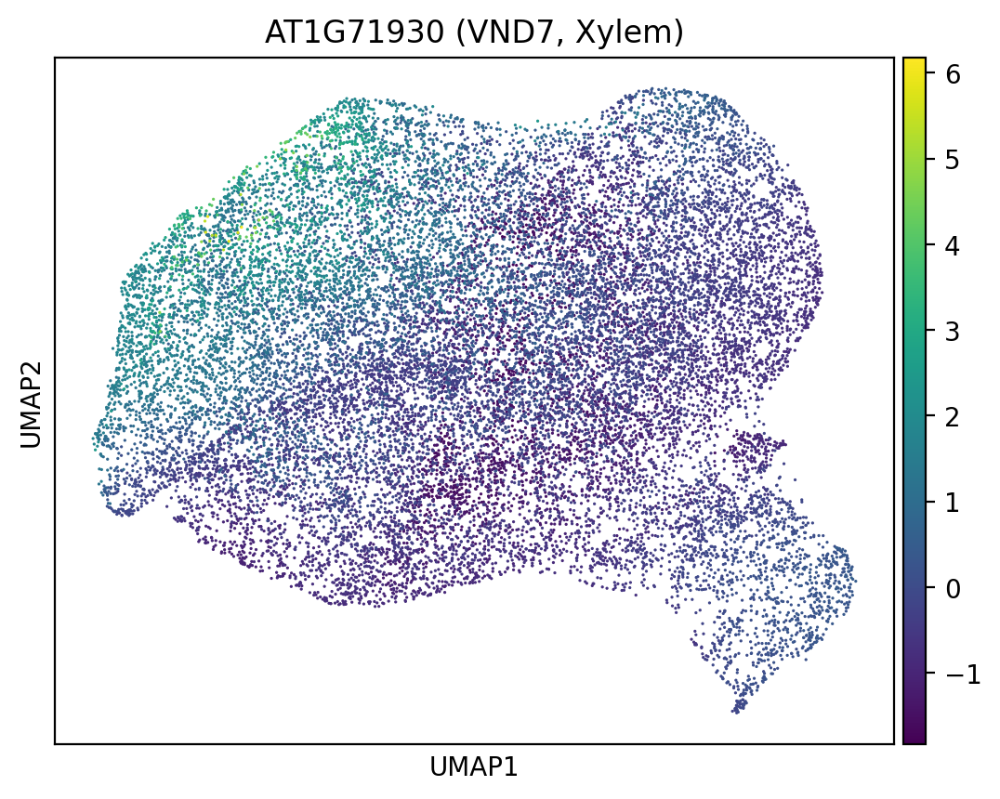

In [29]:
## 88 genes
Masked_995 = masked_genes_estimate_recovery(0.995, "./Masked_995_celltype_recovery.csv")